In [1]:
import pickle
import pandas as pd
import plotly.express as px
import datetime
from magplots.magFunctions import * # packaged version
# from magFunctions import * # local version

# Event Selection

In [2]:
with open('themis_event_list_with_coords.pkl', 'rb') as f:
    themis_events = pickle.load(f)
themis_events = themis_events.rename(columns={"Jet Number": "Original Jet Number"})
themis_events['Jet Number'] = np.arange(len(themis_events))+2 # preventing numbers from looping, but making them consistent
themis_events.shape

(10236, 24)

In [3]:
# TESTING - DELETE

## Magfig for that day in 2016 with a northern and equatorial jet in the same day:

# help(magfig)
events      = [{'datetime':datetime.datetime(2016, 6, 23, 20, 46, 33),'label':'Northern Jet'}]
events += [{'datetime': datetime.datetime(2016, 6, 23, 23, 21, 54),'label': 'Equatorial Jet'}]
# magfig(parameter='Bx', start=datetime.datetime(2016, 6, 23, 20, 15), end=datetime.datetime(2016, 6, 23, 21, 46), maglist_a=['upn', 'umq', 'gdh', 'atu', 'skt', 'ghb'], maglist_b=['pg0', 'pg1', 'pg2', 'pg3', 'pg4', 'pg5'], is_displayed=False, is_saved=True, events=events, event_fontdict={'size': 20, 'weight': 'bold'})
magfig(parameter='Bx', start=datetime.datetime(2016, 6, 23, 20, 15), end=datetime.datetime(2016, 6, 24, 0, 30), maglist_a=['upn', 'umq', 'gdh', 'atu', 'skt', 'ghb'], maglist_b=['pg0', 'pg1', 'pg2', 'pg3', 'pg4', 'pg5'], is_displayed=False, is_saved=True, events=events, event_fontdict={'size': 20, 'weight': 'bold'})
magfig(parameter='By', start=datetime.datetime(2016, 6, 23, 20, 15), end=datetime.datetime(2016, 6, 24, 0, 30), maglist_a=['upn', 'umq', 'gdh', 'atu', 'skt', 'ghb'], maglist_b=['pg0', 'pg1', 'pg2', 'pg3', 'pg4', 'pg5'], is_displayed=False, is_saved=True, events=events, event_fontdict={'size': 20, 'weight': 'bold'})
magfig(parameter='Bz', start=datetime.datetime(2016, 6, 23, 20, 15), end=datetime.datetime(2016, 6, 24, 0, 30), maglist_a=['upn', 'umq', 'gdh', 'atu', 'skt', 'ghb'], maglist_b=['pg0', 'pg1', 'pg2', 'pg3', 'pg4', 'pg5'], is_displayed=False, is_saved=True, events=events, event_fontdict={'size': 20, 'weight': 'bold'})



Looks like output/2016-06-23 201500_Bx.png has already been generated.
Looks like output/2016-06-23 201500_By.png has already been generated.
Looks like output/2016-06-23 201500_Bz.png has already been generated.


In [4]:
# for i in [11, 200, 261, 267, 270, 461, 799, 661, 242, 247, 31, 274, 211, 251]:
# for i in [11, 200, 261, 267, 3270, 3461, 799, 3661, 6242, 6247, 1031, 6274, 1211, 4251]:
foo = themis_events[themis_events["Jet Number"].isin([11, 200, 261, 267, 3270, 3461, 799, 3661, 6242, 6247, 1031, 6274, 1211, 4251])]
print(foo [['Original Jet Number','Jet Number' ]])

                     Original Jet Number  Jet Number
Max                                                 
2013-01-03 12:39:03                   11          11
2014-02-19 03:47:07                  200         200
2015-04-05 19:14:46                  261         261
2015-04-11 23:25:08                  267         267
2016-05-20 08:34:10                  799         799
2016-06-23 23:21:54                   31        1031
2016-07-08 21:29:34                  211        1211
2015-04-18 03:10:58                  270        3270
2015-05-15 05:25:53                  461        3461
2016-06-13 03:19:36                  661        3661
2018-09-08 11:06:02                  251        4251
2016-06-16 15:13:57                  242        6242
2016-06-19 15:24:27                  247        6247
2016-06-30 17:56:42                  274        6274


Add a column named 'Count' that shows the number of events per two-hour period:
<!-- # themis_events['Count'] = themis_events.groupby(themis_events['Start'].dt.date)['Jet Number'].transform('count') -->

In [5]:
def count_events_within_window_iterative(df):
  """
  This function iterates through each row and calculates the count of events
  within the 2-hour window relative to that row's index time.

  Args:
      df: The pandas DataFrame to be processed.

  Returns:
      A new DataFrame with the added 'Count' column.
  """

  df['Count'] = 0  # Initialize the 'Count' column with zeros
  for index, row in df.iterrows():
    # Extract current row's 'Start' time and window bounds
    start_time = row['Start']
    window_start = start_time - pd.Timedelta(hours=1)
    window_end = start_time + pd.Timedelta(hours=1)

    # Count events within the window (excluding the current row)
    count = (df['Start'] >= window_start) & (df['Start'] < window_end) & (df['Start'] != start_time)
    df.loc[index, 'Count'] = count.sum()  # Assign the count to the current row

  return df

# Apply the function to your DataFrame
themis_events = count_events_within_window_iterative(themis_events)

## Downselect: Data in both hemispheres
We want to select only events with magnetometer coverage from both AALPIP and the DTU stations.

In [6]:
# themis_events = themis_events[themis_events['Start'] > datetime.datetime(2016, 1, 1)]
themis_events.shape

(10236, 25)

## Downselect: Check Magnetic Meridian
Consider only the cases where transients occurred within +/-2 hours local time of the 40-degree magnetic meridian. This region is selected because of the density of ground stations available in both hemispheres.

To check this, we'll pull satellite coordinates from https://cdaweb.gsfc.nasa.gov/. Using orbit parameters for spacecraft of interest (e.g., `THA_OR_SSC`), we can find their positions in a cylindrical coordinate system around Earth. We can then check if their longitude in SM coordinates is within 60&deg; of the latitude of our ground stations, since 60&deg; maps to +/- 2 hours out of 24.

In [7]:
pm = 30   # 30 degrees of margin
themis_events = themis_events.drop(themis_events[(themis_events['SM_LON'] <= 40 - pm) ].index)
themis_events = themis_events.drop(themis_events[(themis_events['SM_LON'] >= 40 + pm) ].index)
themis_events.head()

,Original Jet Number,Ref Spacecraft,Start,End,SM_LAT,SM_LON,SM_X,SM_Y,SM_Z,GEO_X_1,...,L_VALUE,INVAR_LAT,MAGNETIC_STRENGTH,Dynamic Pressure (nPa),Electron density,Vx,Vy,Vz,Jet Number,Count
Max,,,,,,,,,,,,,,,,,,,,,
2012-12-16 23:56:43,2,A,2012-12-16 23:56:31,2012-12-16 23:57:07,-3.26014,19.5236,10.8744,3.85587,-0.657211,-10.6029,...,11.5940,72.9212,-1.000000e+31,2.894031,0.278323,-74.203164,41.282661,5.197419,2,3
2012-12-17 00:00:14,3,A,2012-12-17 00:00:10,2012-12-17 00:01:26,-3.43351,19.7288,10.8709,3.89850,-0.692903,-10.6780,...,11.6112,72.9343,-1.000000e+31,1.882750,10.259104,-35.856940,129.441884,-112.543848,3,3
2012-12-17 00:06:13,4,A,2012-12-17 00:06:03,2012-12-17 00:06:37,-3.69346,20.0407,10.8639,3.96289,-0.746493,-10.7858,...,11.6365,72.9534,-1.000000e+31,1.882750,10.259104,-35.856940,129.441884,-112.543848,4,3
2012-12-17 00:08:48,5,A,2012-12-17 00:08:35,2012-12-17 00:09:34,-3.78059,20.1425,10.8614,3.98382,-0.764470,-10.8206,...,11.6448,72.9596,-1.000000e+31,1.882750,10.259104,-35.856940,129.441884,-112.543848,5,3
2012-12-28 11:51:23,6,A,2012-12-28 11:51:00,2012-12-28 11:51:28,-2.73318,11.2758,10.9408,2.18139,-0.532586,10.9549,...,11.1943,72.6095,-1.000000e+31,2.385924,50.471666,-222.940315,82.164582,12.665370,6,21


In [8]:
themis_events.shape

(2865, 25)

## Downselect: Filter down to isolated jets: 

In [9]:
# filter down to isolated jets:
themis_events = themis_events.drop(themis_events[(themis_events['Count'] > 0) ].index)
print(themis_events.shape)
themis_events.head()

(106, 25)


,Original Jet Number,Ref Spacecraft,Start,End,SM_LAT,SM_LON,SM_X,SM_Y,SM_Z,GEO_X_1,...,L_VALUE,INVAR_LAT,MAGNETIC_STRENGTH,Dynamic Pressure (nPa),Electron density,Vx,Vy,Vz,Jet Number,Count
Max,,,,,,,,,,,,,,,,,,,,,
2013-01-03 12:39:03,11,A,2013-01-03 12:38:52,2013-01-03 12:39:57,-5.78113,21.5338,10.31680,4.07093,-1.12289,10.87490,...,11.2619,72.6634,-1.000000e+31,1.338730,52.166798,61.113694,85.116916,140.548073,11,0
2014-02-06 04:13:53,198,A,2014-02-06 04:13:51,2014-02-06 04:13:55,-15.8504,28.2922,9.66589,5.20284,-3.11666,-9.54821,...,12.3309,73.4546,-1.000000e+31,1.103909,1.186837,-70.358194,121.167559,-120.953222,198,0
2014-02-14 11:50:12,199,A,2014-02-14 11:49:58,2014-02-14 11:50:26,-9.24019,20.0124,10.53060,3.83540,-1.82326,10.16620,...,11.6552,72.9675,-1.000000e+31,0.712753,46.354640,-98.783099,84.033650,-39.934024,199,0
2014-02-19 03:47:07,200,A,2014-02-19 03:46:41,2014-02-19 03:50:20,-15.4036,18.1950,10.49160,3.44846,-3.04272,-9.23353,...,12.3249,73.4504,-1.000000e+31,2.718910,51.952233,-132.704772,53.695938,11.362804,200,0
2014-02-20 03:54:06,201,A,2014-02-20 03:53:54,2014-02-20 03:56:28,-14.1338,22.6060,10.17640,4.23728,-2.77577,-9.47016,...,12.0882,73.2845,-1.000000e+31,4.467021,11.436235,-679.596490,-27.300943,-72.045720,201,0


## Visualization: Scatterplots
We can plot the downselected events according to various criteria.

In [10]:
fig = px.scatter(themis_events, x = 'SM_Y', y = 'SM_Z', hover_data = ['Jet Number', 'Start', 'Dynamic Pressure (nPa)'], color = 'DIST_FROM_MAGNETOPAUSE', range_color=(0,1))
fig.update_layout(dragmode='select',
                  newselection=dict(line=dict(color='blue')))
fig.write_html('dist')
fig.show()

In [11]:
fig = px.scatter(themis_events, x = 'Dynamic Pressure (nPa)', y = 'SM_Z', hover_data = ['Jet Number', 'Start', 'SM_Y', 'Ref Spacecraft'], color = 'DIST_FROM_MAGNETOPAUSE', range_color=(0,1))
fig.update_layout(dragmode='select',
                  newselection=dict(line=dict(color='blue')))
fig.write_html('dist')
fig.show()

In [12]:
fig = px.scatter(themis_events, x = 'DIST_FROM_MAGNETOPAUSE', y = 'SM_Z', hover_data = ['Jet Number', 'Start', 'SM_Y', 'Ref Spacecraft'], color = 'Dynamic Pressure (nPa)', range_color=(0,1))
fig.update_layout(dragmode='select',
                  newselection=dict(line=dict(color='blue')))
fig.write_html('dist')
fig.show()

In [13]:
fig = px.scatter(themis_events, x = 'SM_Y', y = 'SM_Z', hover_data = ['Jet Number', 'Start', 'Count', 'Dynamic Pressure (nPa)', 'DIST_FROM_MAGNETOPAUSE', 'DIST_FROM_T95_NS', 'Ref Spacecraft'], 
                 # symbol = 'Ref Spacecraft', 
                 color = 'Dynamic Pressure (nPa)', range_color=(0,10))
fig.update_layout(dragmode='select',
                  newselection=dict(line=dict(color='blue')))
fig.write_html('dyn.html')
fig.show()

In [14]:
fig = px.scatter(themis_events, x = 'SM_Y', y = 'SM_Z', hover_data = ['Count', 'Jet Number', 'Start', 'Dynamic Pressure (nPa)', 'DIST_FROM_MAGNETOPAUSE', 'DIST_FROM_T95_NS'], color = 'Count', range_color=(0,10))
fig.update_layout(dragmode='select',
                  newselection=dict(line=dict(color='blue')))
fig.write_html('count.html')
fig.show()

# Import selected events with notes:
We manually reviewed the plots according to the following criteria: 

- Overarching Goal 1: intehemispheric comparisons of mesoscale variations related to Pc5 wave activity caused by jets
  - Requirement 1: The jet must be at the same local time as the AALPIP/DTU conjugate network
  - Requirement 2: At least 4 conjugate magnetometers in both hemispheres with mesoscale spacing (AALPIP/DTU conjugate network is the only one of this type) 
  - Requirement 3: Pc5 waves must be clearly observed immediately following the jet
  - Soft Requirement 4: There must be little wave activity happening before the jet to make the case clear that the jet is causing the wave
  - Soft Requirement 5: Immediately before, during, and after the jet the background magnetic activity should be relatively weak so that it’s possible to conduct Fourier analysis without contamination (i.e., no spikes, big dips, etc – this fouls up the Fourier analysis and causes spurious power that might be mistaken for waves)   
 - Overarching Goal 2: Examine at least 2 events with different jet locations but everything else that’s known to affect Pc5 wave amplitudes as similar as possible (local time, day of year, jet dynamic pressure, other solar wind conditions like IMF Bz) to do more of a controlled experiment on the effect of jet position of IH asymmetries
   - Requirement 1: Select at least one jet at positive SM z
   - Requirement 2: Select at least one jet at negative SM z
   - Requirement 3: Have both jets occur at roughly the SM y position (or at least both positive SM y, both negative SM y, etc)
   - Soft Requirement 4 (related to 3): Have both jets occur at roughly the same time of day
   - Soft Requirement 5: Select jets that occur at roughly the same time of year (e.g., both near northern winter, both near spring equinox) to reduce effects related to ionospheric conductance
   - Soft Requirement 6: Select jets with similar dynamic pressures and/or x component of velocity (e.g. within a factor of 2)


In [15]:
# selected_events = themis_events[themis_events['Jet Number'].isin([31, 461, 242])] #final selection
# selected_events.to_csv('output/selected/selected_events.csv')

selected_events = pd.read_csv('selected_HSJ_events_with_notes.csv')
selected_events["Max"] = pd.to_datetime(selected_events["Max"])
selected_events["Start"] = pd.to_datetime(selected_events["Start"])
selected_events["End"] = pd.to_datetime(selected_events["End"])
selected_events = selected_events.set_index('Max')
selected_events = selected_events[selected_events["Selected"] == True]

### Export table of selected events:

In [16]:
summary = selected_events.copy()
summary = summary.drop(["Start", "End"], axis = 1)
print(summary.to_markdown())
# print(summary.to_latex())

| Max                 |   Month |   Jet Number |   Original Jet Number | Selected   | Notes                                                                                                                                                                                                                                                                                                                                                   |   Number of comparison points | Ref Spacecraft   |       SM_LAT |   SM_LON |     SM_X |    SM_Y |         SM_Z |    GEO_X_1 |   GEO_Y_1 |     GEO_Z_1 |   DIST_FROM_P93_BOW_SHOCK |   DIST_FROM_MAGNETOPAUSE |   DIST_FROM_T95_NS |   L_VALUE |   INVAR_LAT |   MAGNETIC_STRENGTH |   Dynamic Pressure (nPa) |   Electron density |         Vx |       Vy |         Vz |
|:--------------------|--------:|-------------:|----------------------:|:-----------|:-------------------------------------------------------------------------------------------------------------------------

In [17]:
selected_events = themis_events[themis_events["Jet Number"].isin([11, 200, 261, 267, 3270, 3461, 799, 3661, 6242, 6247, 1031, 6274, 1211, 4251])]

# Plot Selected Events:

In [18]:
fig = px.scatter(selected_events, x = 'SM_Y', y = 'SM_Z', hover_data = ['Jet Number', 'Start', 'Dynamic Pressure (nPa)', 'DIST_FROM_MAGNETOPAUSE', 'DIST_FROM_T95_NS', 'Ref Spacecraft'], 
                 # symbol = 'Ref Spacecraft', 
                 color = 'Dynamic Pressure (nPa)', range_color=(0,10))
fig.update_layout(dragmode='select',
                  newselection=dict(line=dict(color='blue')))
fig.write_html('dyn-reduced.html')
fig.show()

## Create time domain, spectrogram plots:

Computing plots for jet #11: 
[{'datetime': Timestamp('2013-01-03 12:39:03'), 'label': 11}]
Plotting Bx for jet #11: 
Plotting data for 6 magnetometers: 2013-01-03 10:38:52
Looks like output/2013-01-03 103852_to_2013-01-03 143957_uniform.csv has already been generated. Pulling data...
                   UT Magnetometer          Bx        By       Bz
0 2013-01-03 10:39:00          ATU   7922.0000  -5300.30  54956.5
1 2013-01-03 10:39:00          GDH   7300.9000  -5095.00  55770.6
2 2013-01-03 10:39:00          GHB   9752.9000  -5300.90  54141.0
3 2013-01-03 10:39:00          PG1    -95.5000   -476.87    -12.9
4 2013-01-03 10:39:00          PG2  17138.9000   -118.29 -50148.1
5 2013-01-03 10:39:00          SKT    999.9999  99999.90  99999.9
6 2013-01-03 10:39:00          UMQ   6788.7000  -4715.90  55064.0
7 2013-01-03 10:39:00          UPN   5530.2000  -4404.90  55538.0
8 2013-01-03 10:39:10          ATU   7921.6000  -5300.90  54956.8
9 2013-01-03 10:39:10          GDH   7300.7000  -5094.

/mnt/c/Users/kvc2/Documents/Space Science Institute/magplots/magFunctions.py:528: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



0.00020714722844794063 75.09450029341929
Setting logarithmic scale on y axis.
Plotting time domain data on spectrogram plot.
Adjusting y-axis limits. Median: 55354.5
[55204.5, 55504.5]
Setting y-axis color for time domain plot.
Plotting data for Arctic magnetometer #2: UMQ
6.197083805018535e-05 109.93219013267469
Setting logarithmic scale on y axis.
Plotting time domain data on spectrogram plot.
Adjusting y-axis limits. Median: 54936.3
[54786.3, 55086.3]
Setting y-axis color for time domain plot.
Plotting data for Arctic magnetometer #3: GDH
2.0786659231614776e-05 110.6498986791608
Setting logarithmic scale on y axis.
Plotting time domain data on spectrogram plot.
Adjusting y-axis limits. Median: 55650.5
[55500.5, 55800.5]
Setting y-axis color for time domain plot.
Plotting data for Arctic magnetometer #4: ATU
0.0003081524993629298 88.25573012914072
Setting logarithmic scale on y axis.
Plotting time domain data on spectrogram plot.
Adjusting y-axis limits. Median: 53983.8
[53833.8, 541

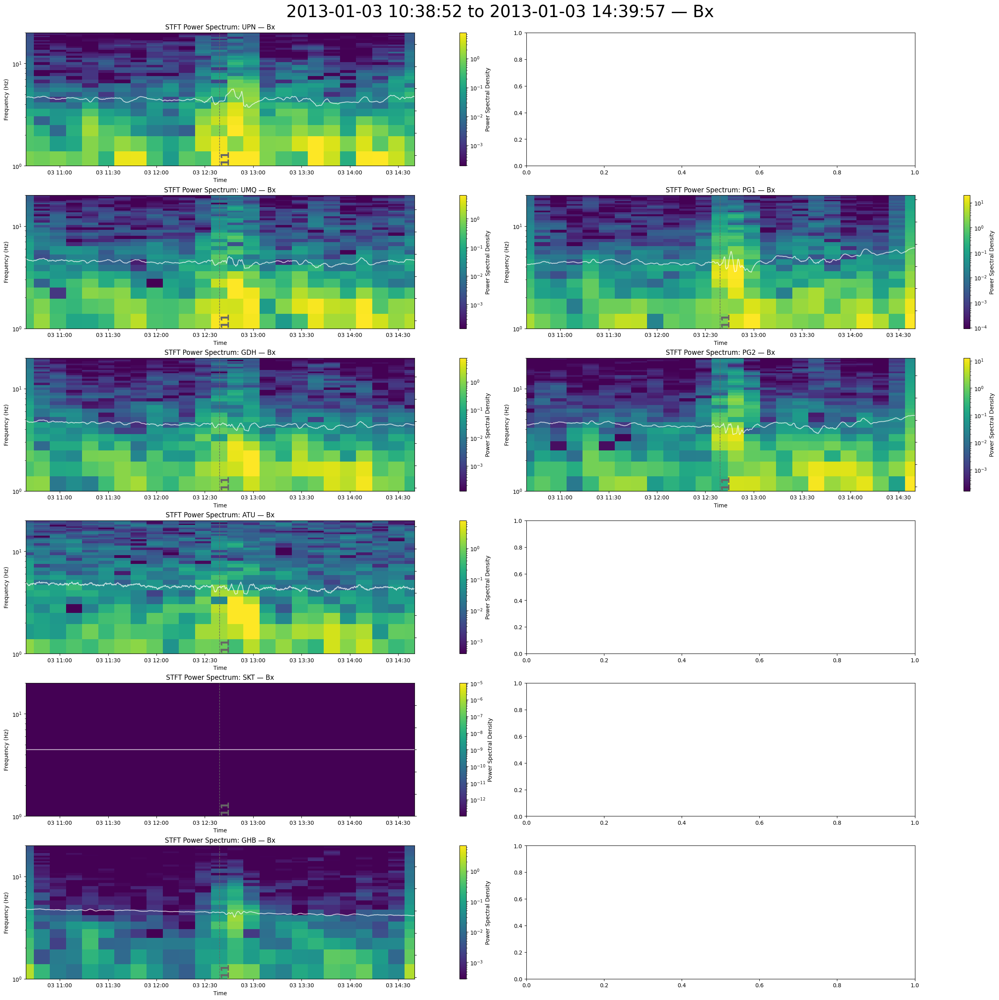

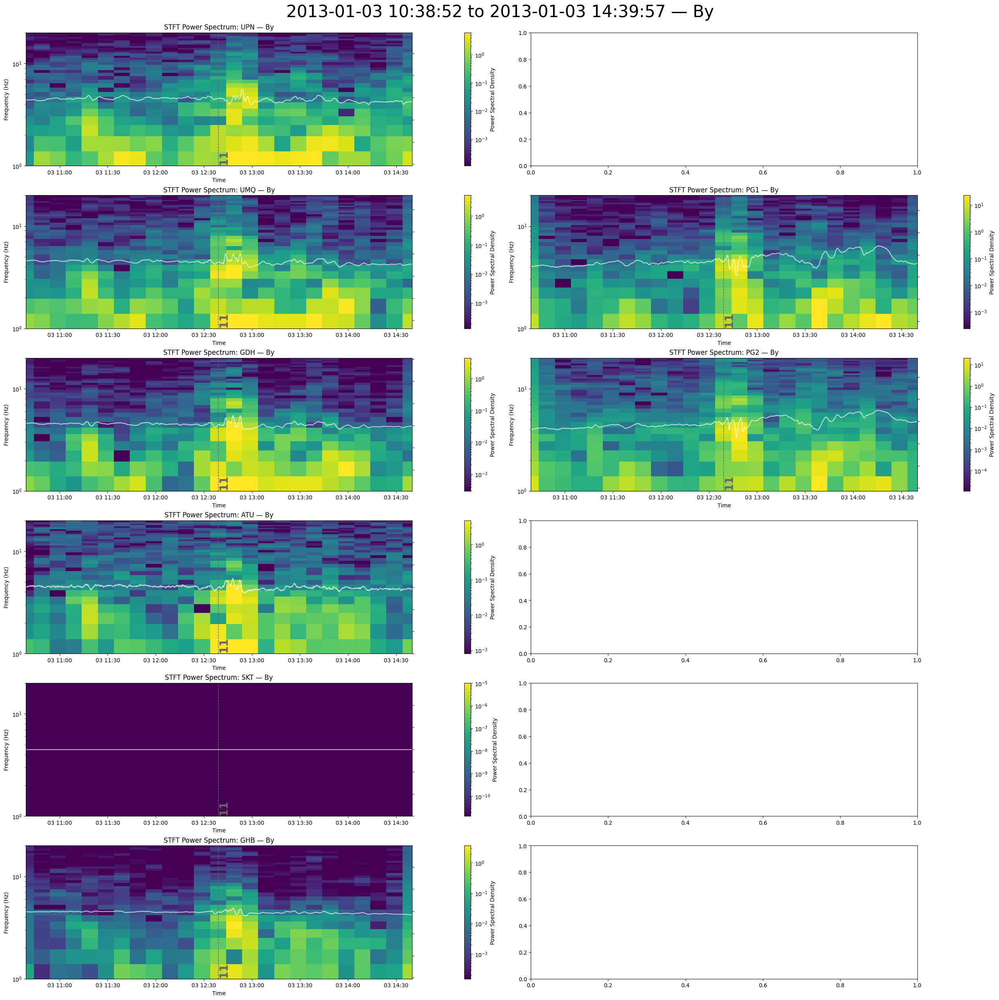

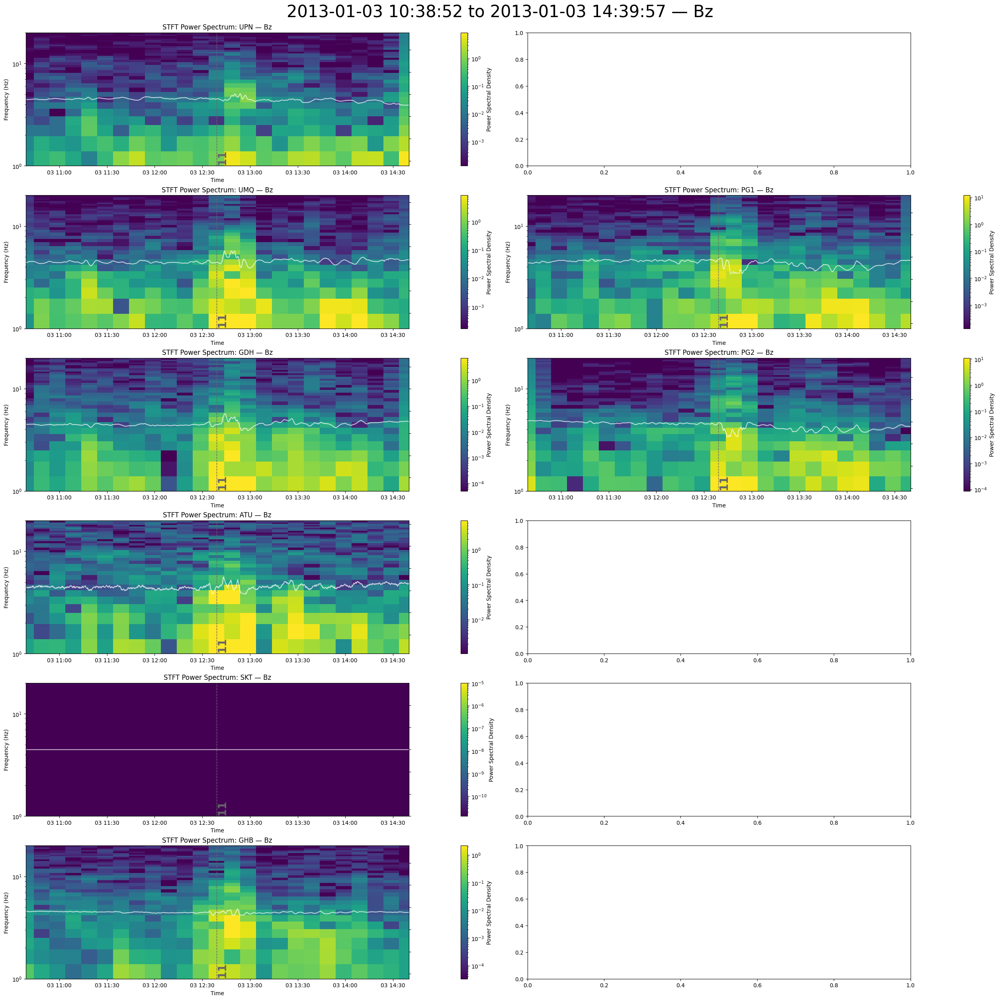

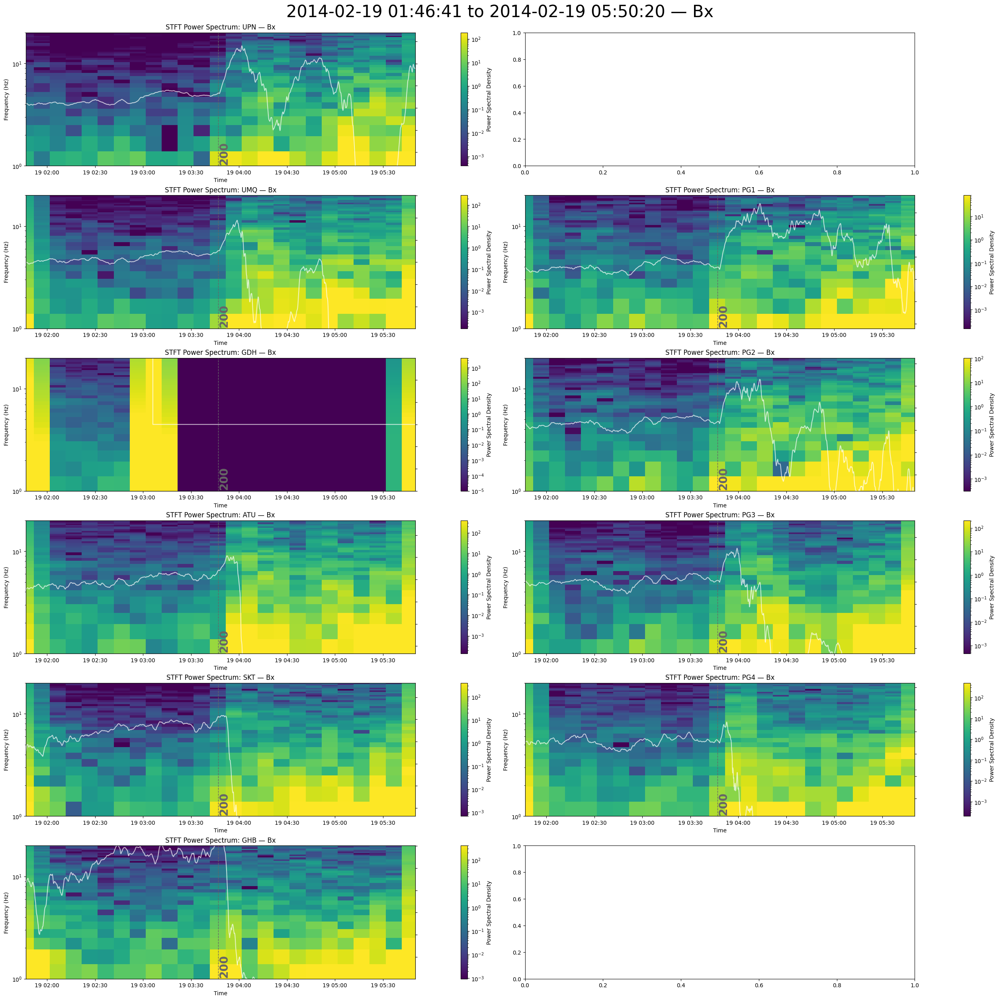

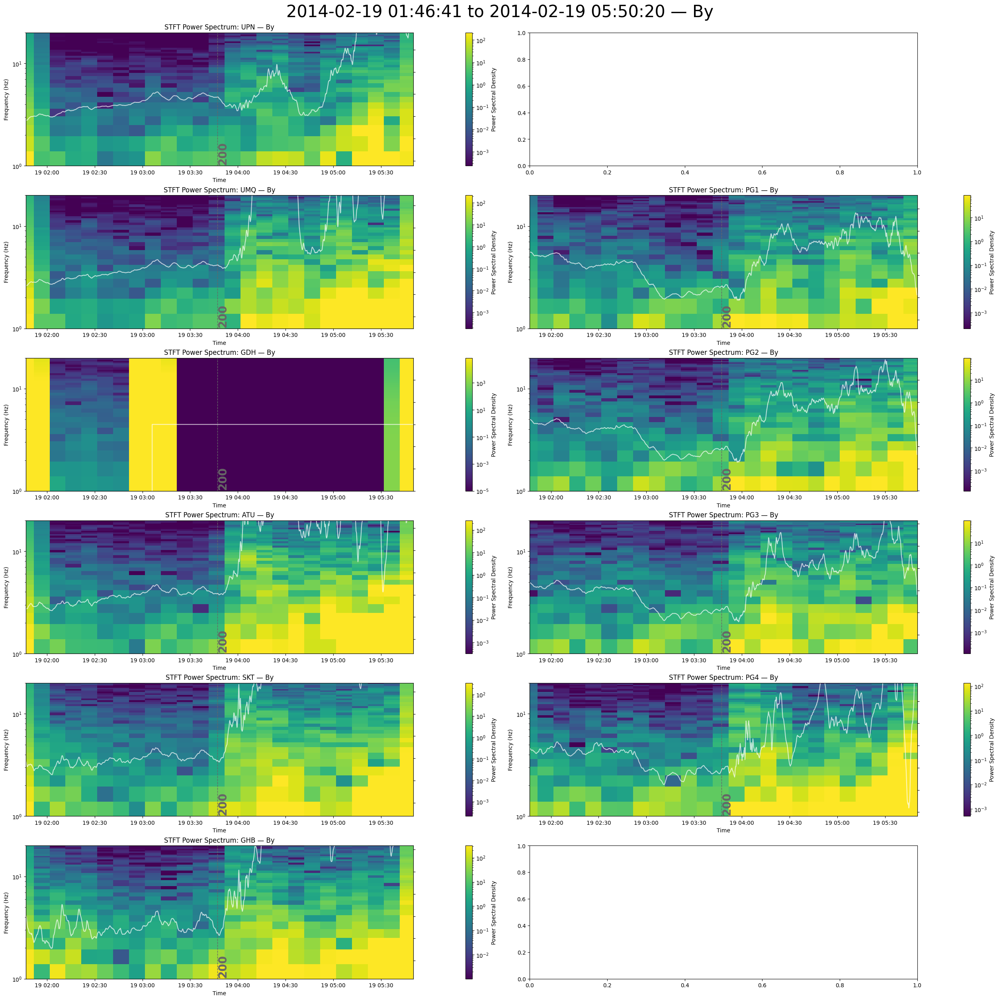

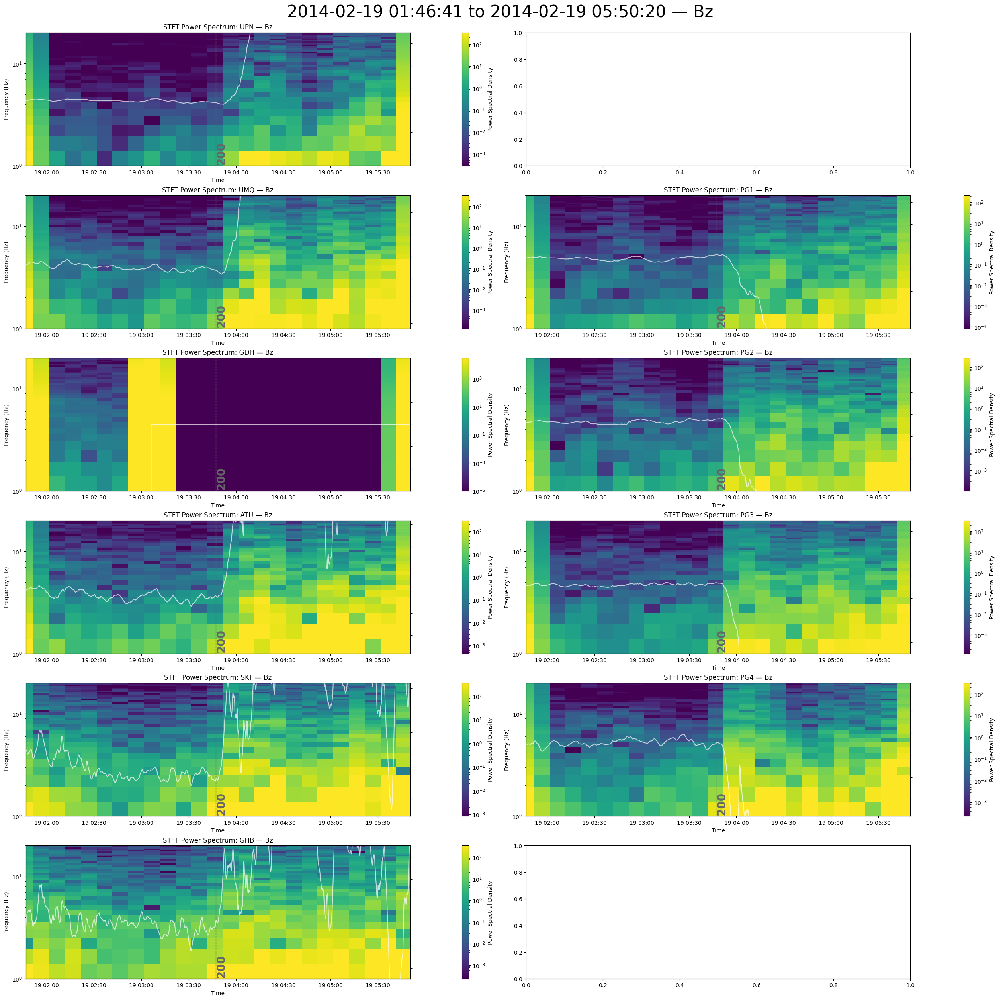

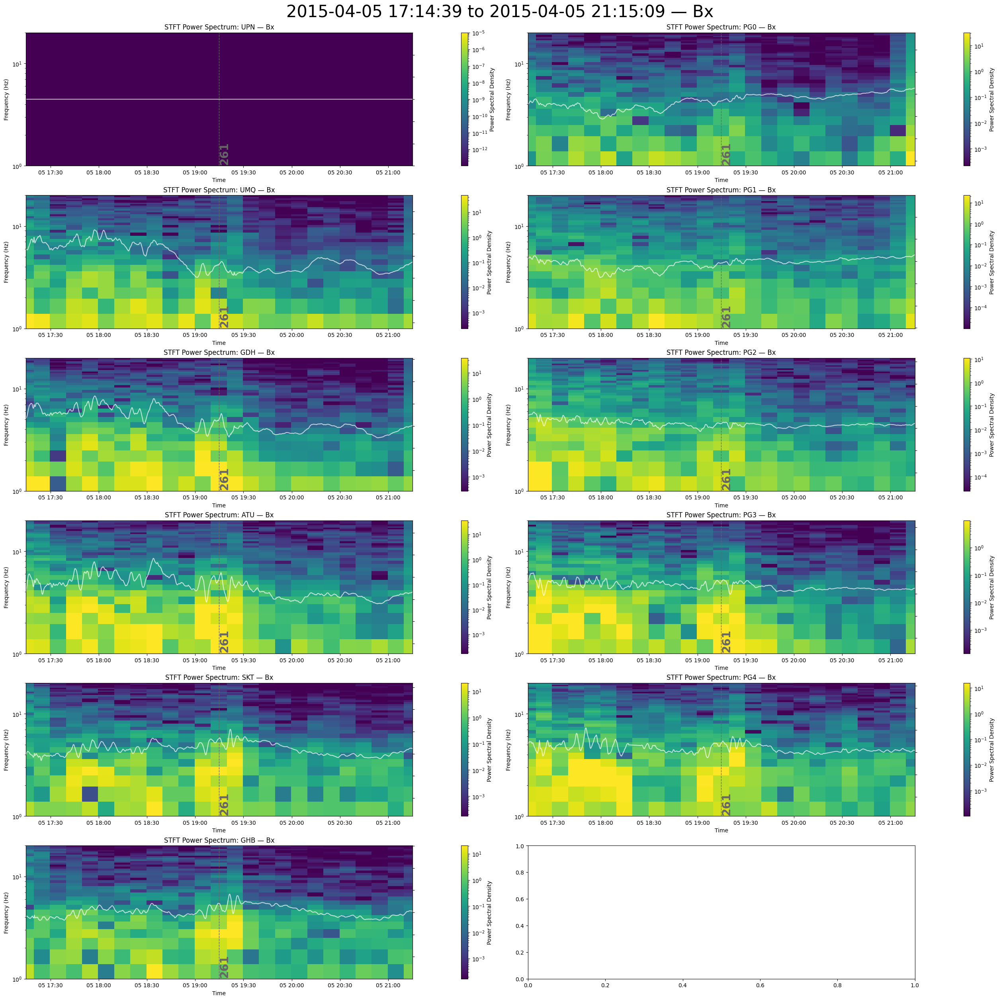

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 33 Axes>

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 33 Axes>

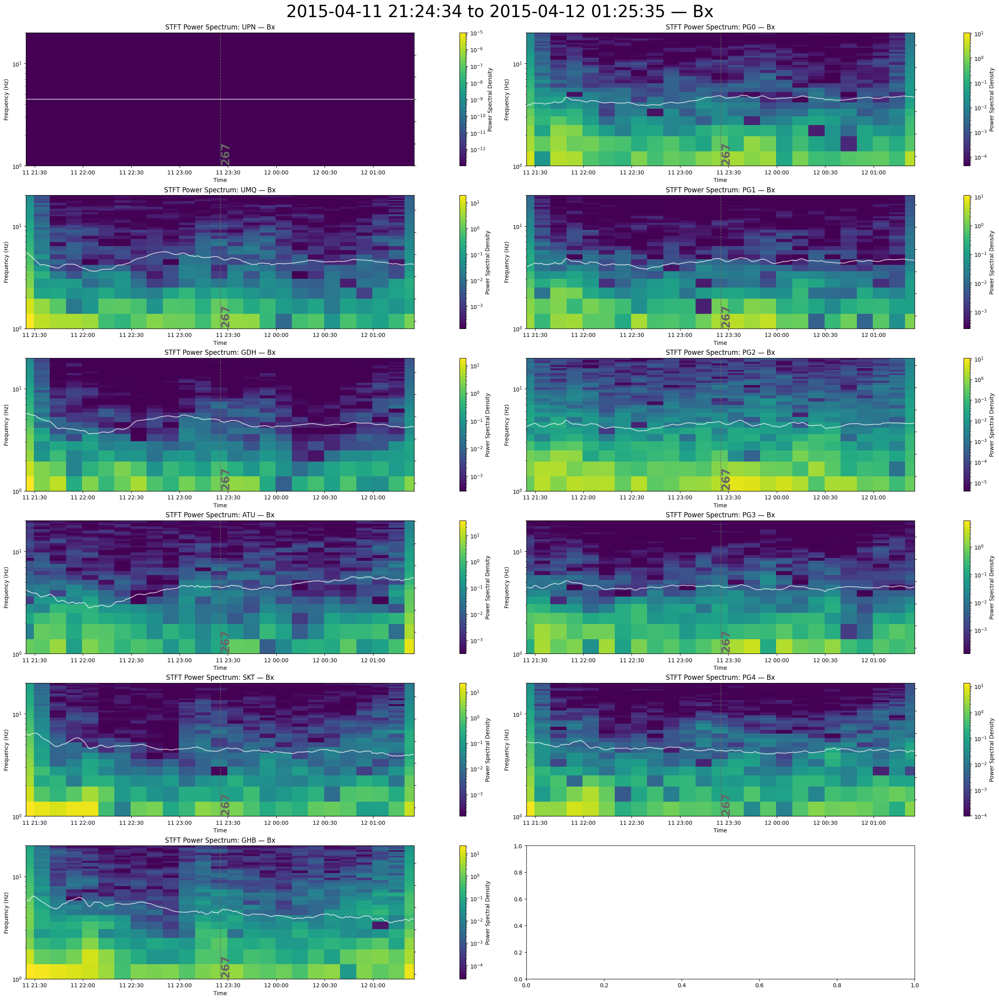

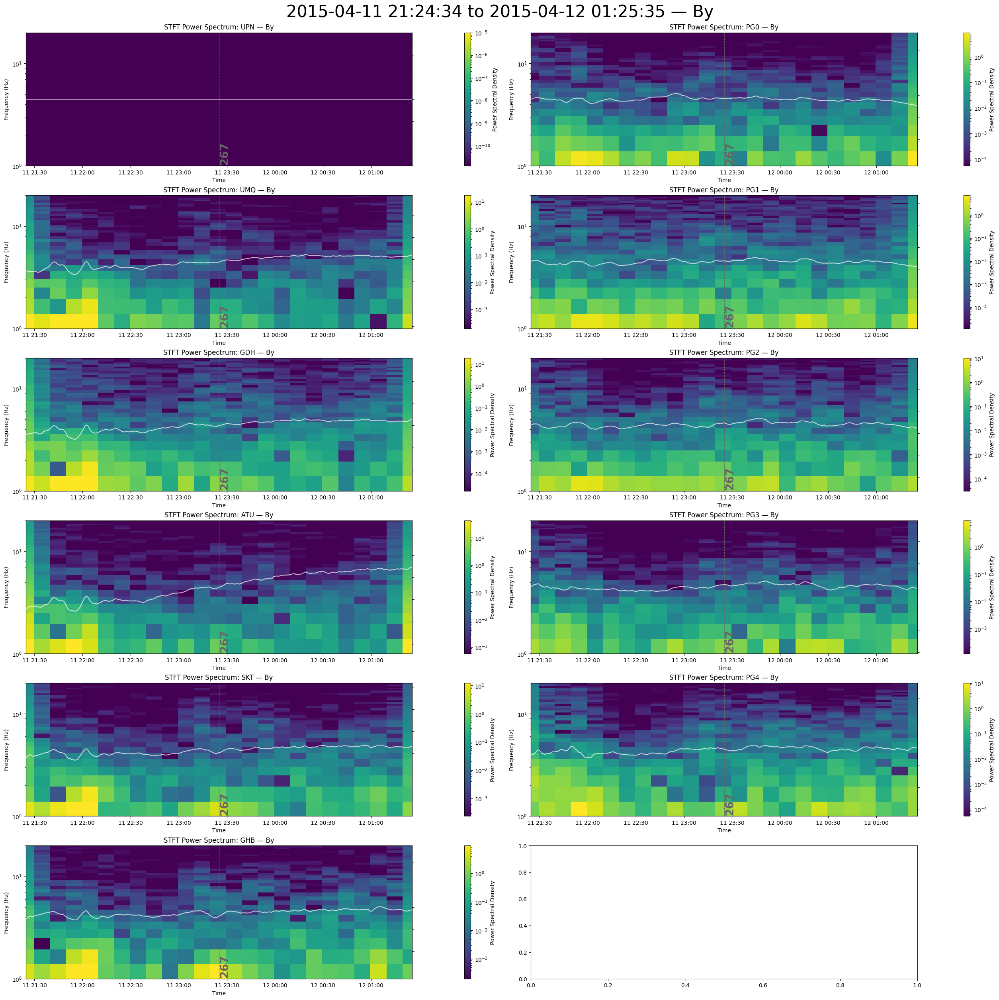

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 33 Axes>

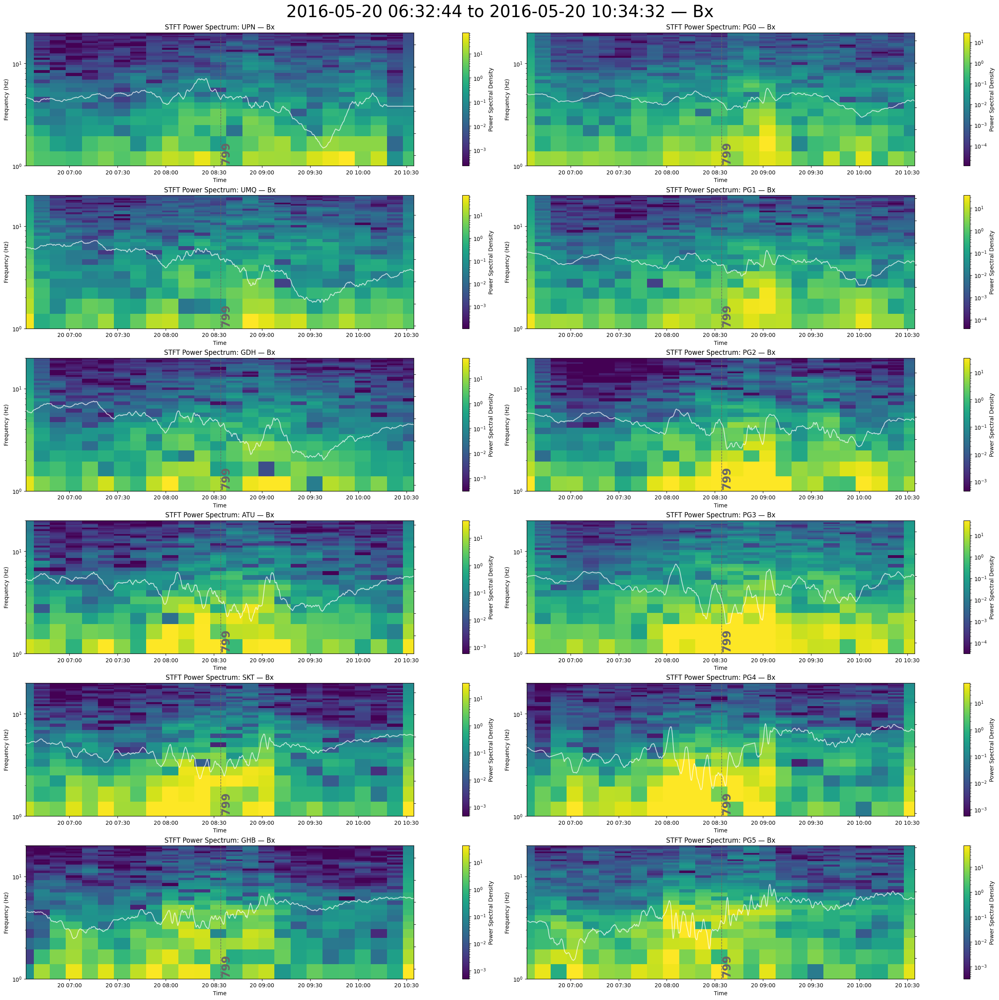

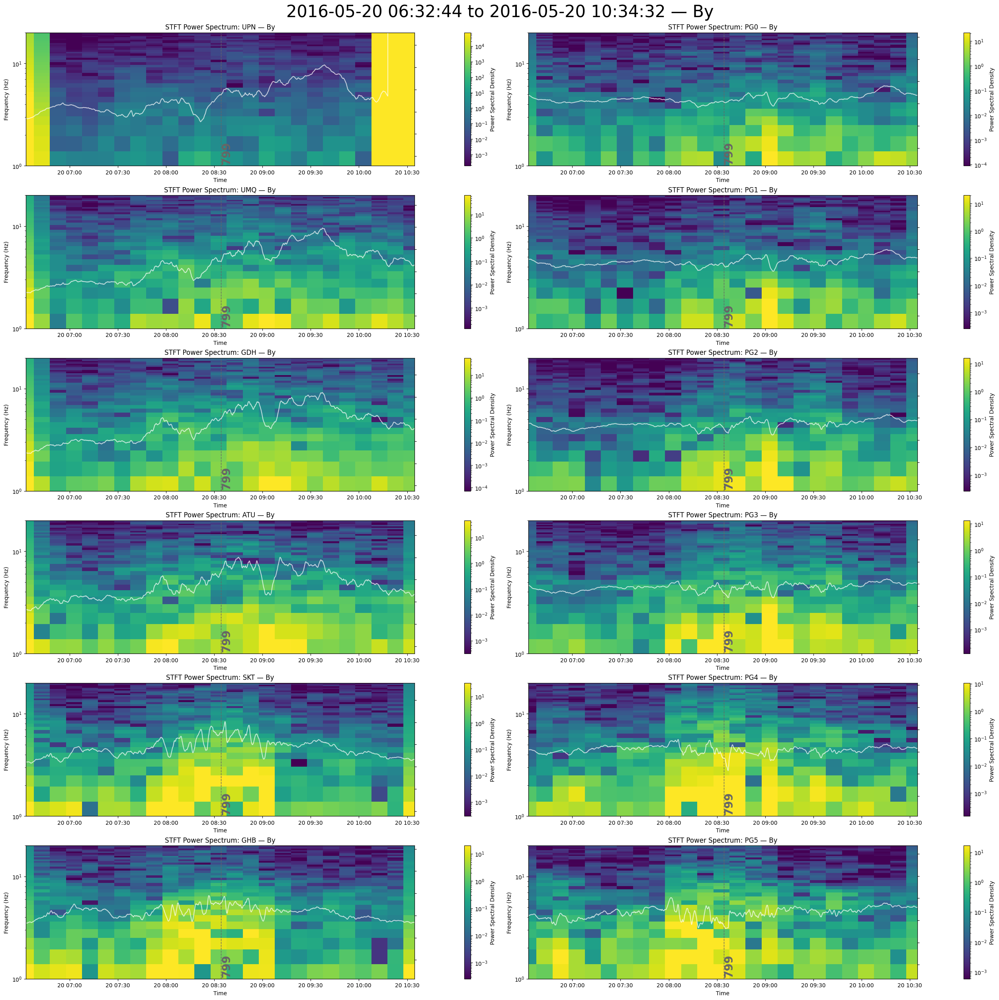

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 35 Axes>

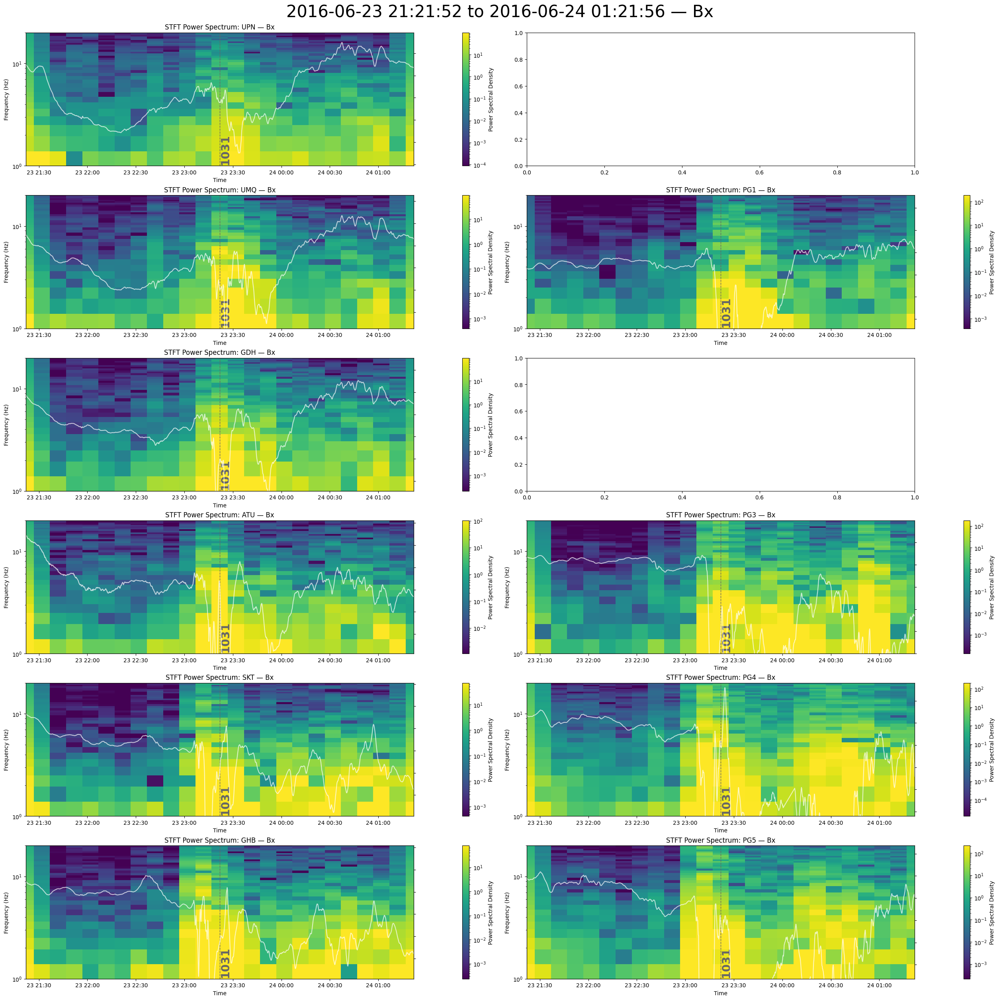

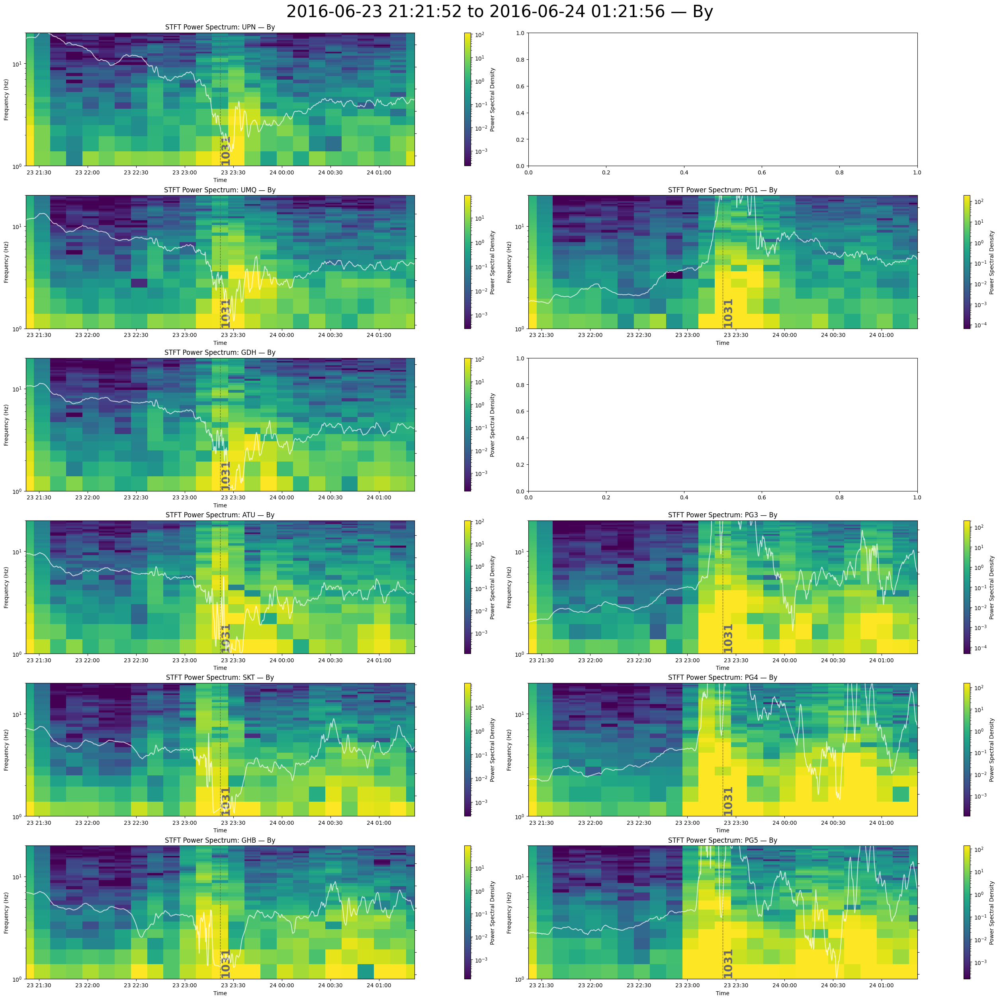

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 31 Axes>

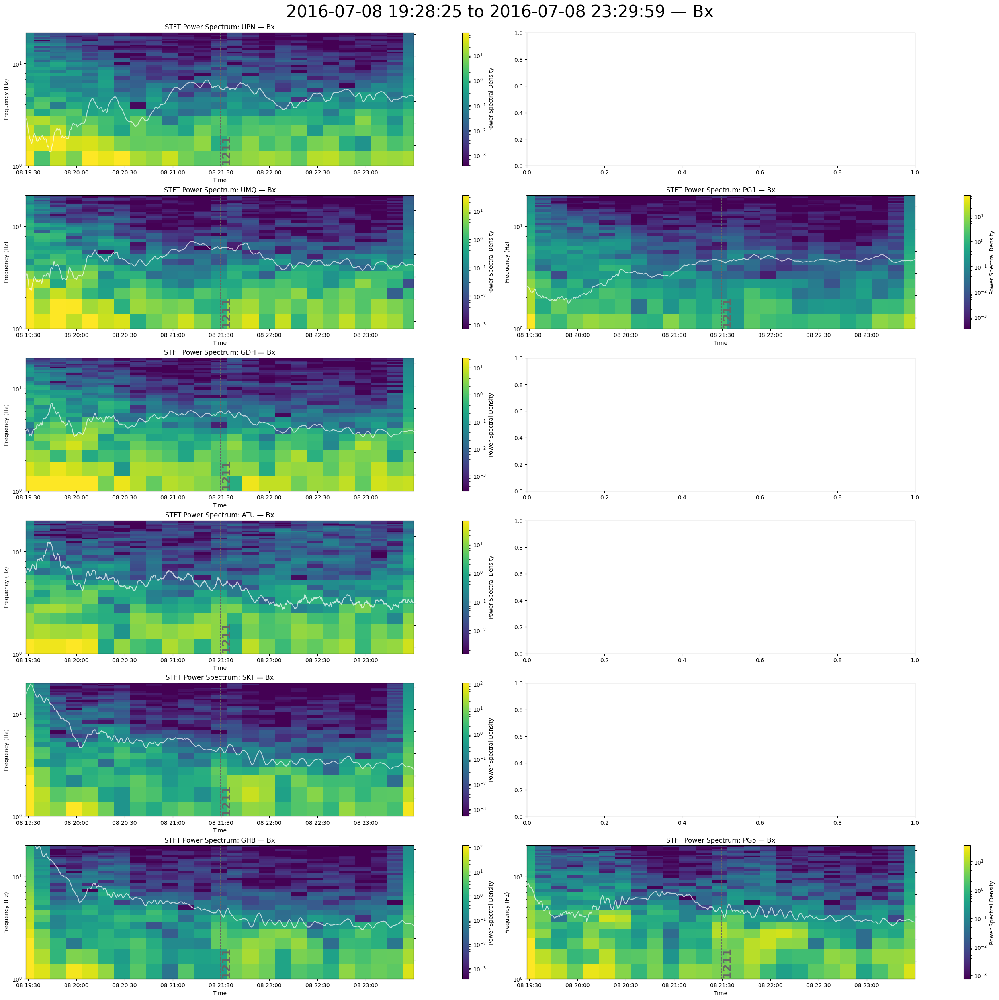

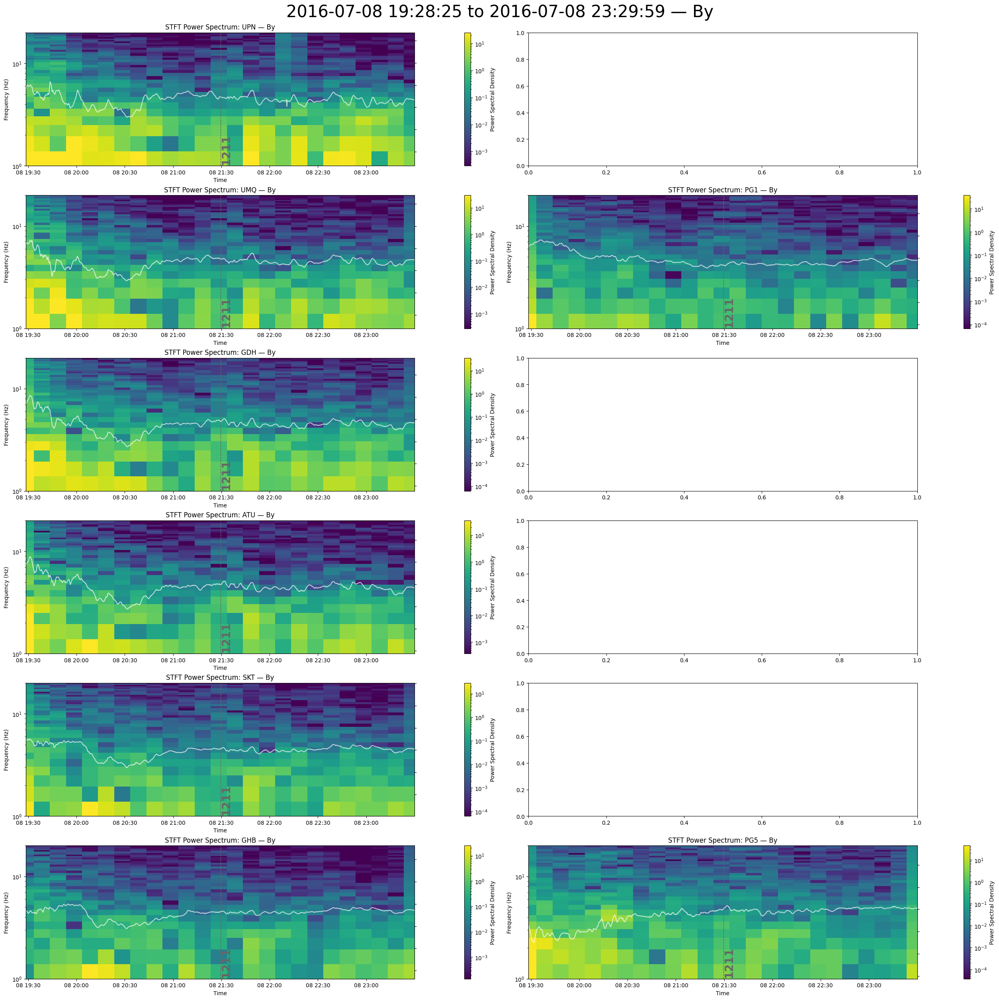

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 27 Axes>

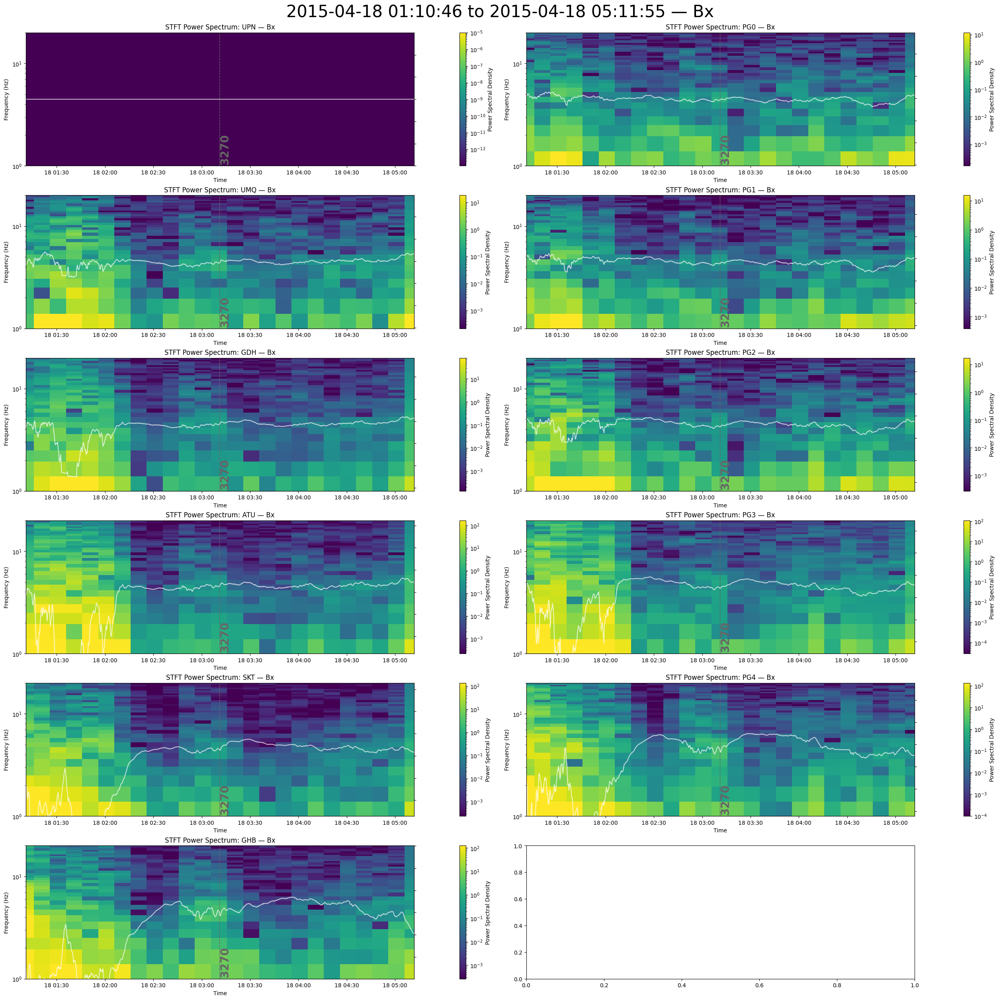

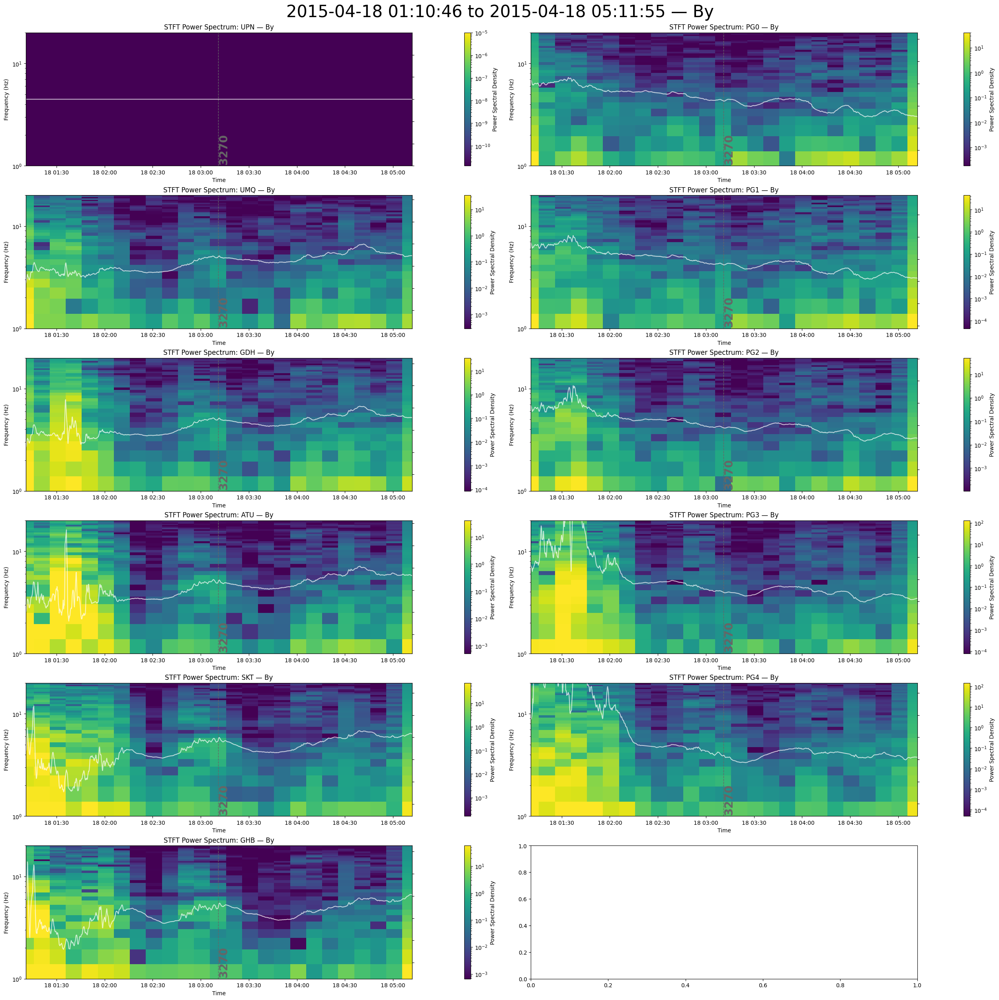

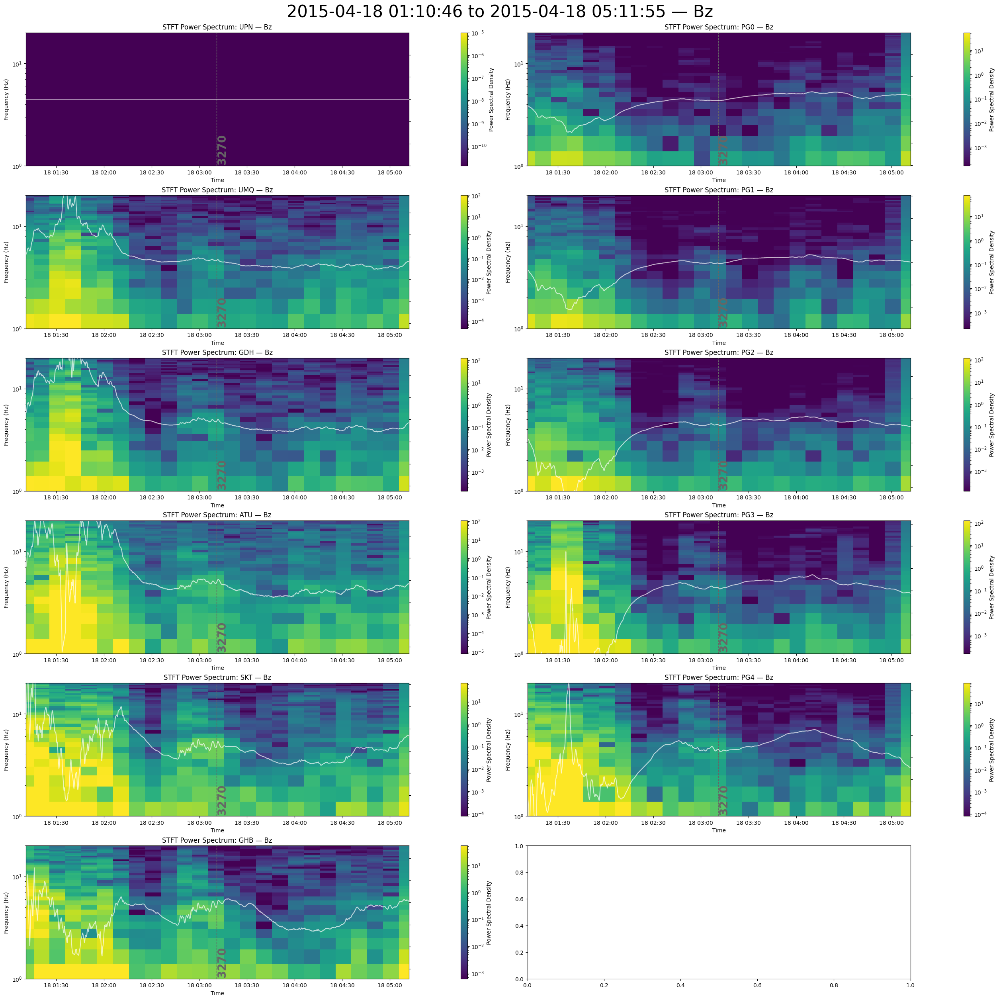

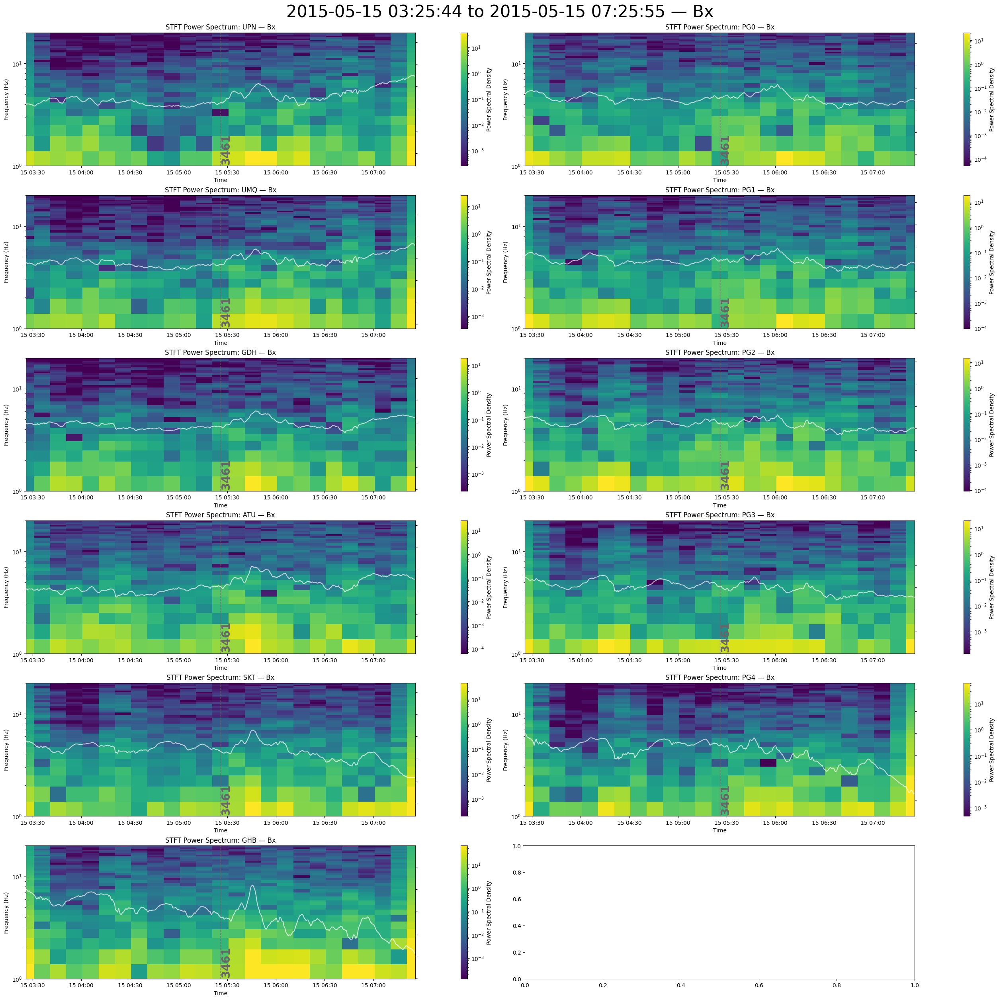

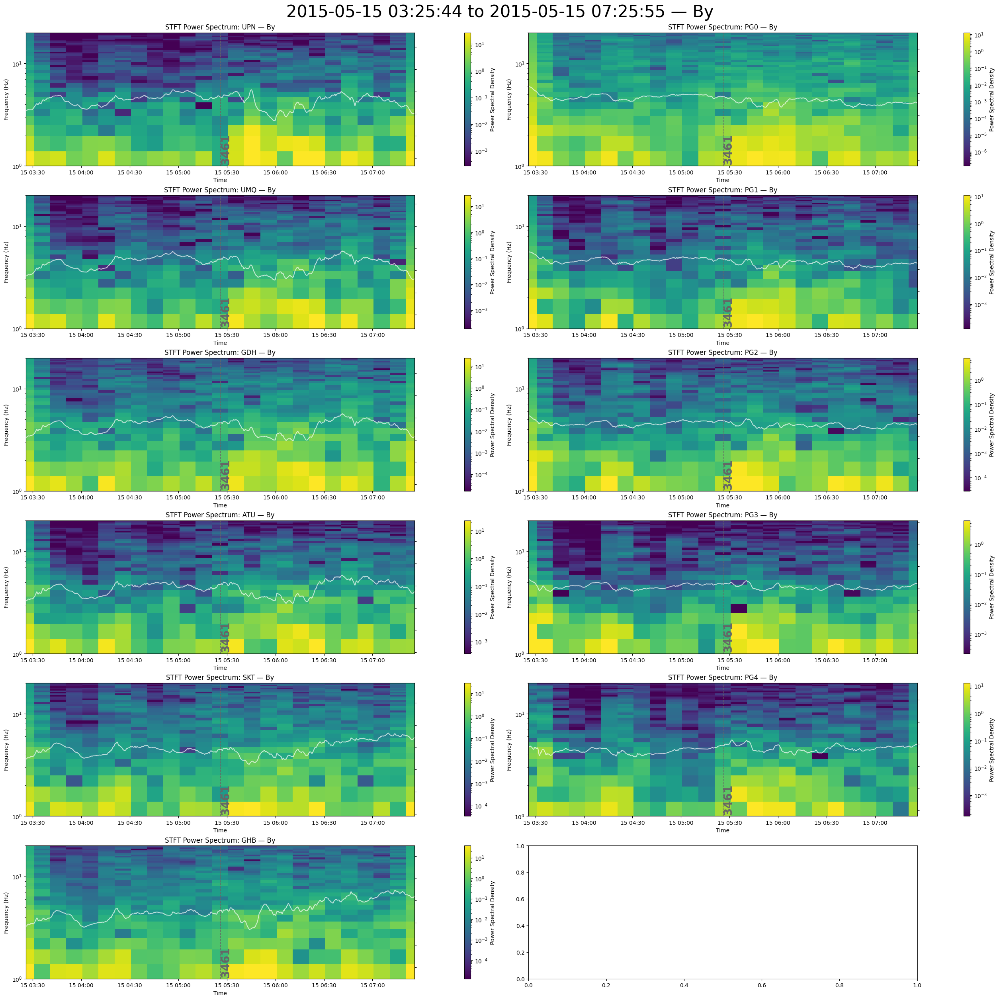

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 33 Axes>

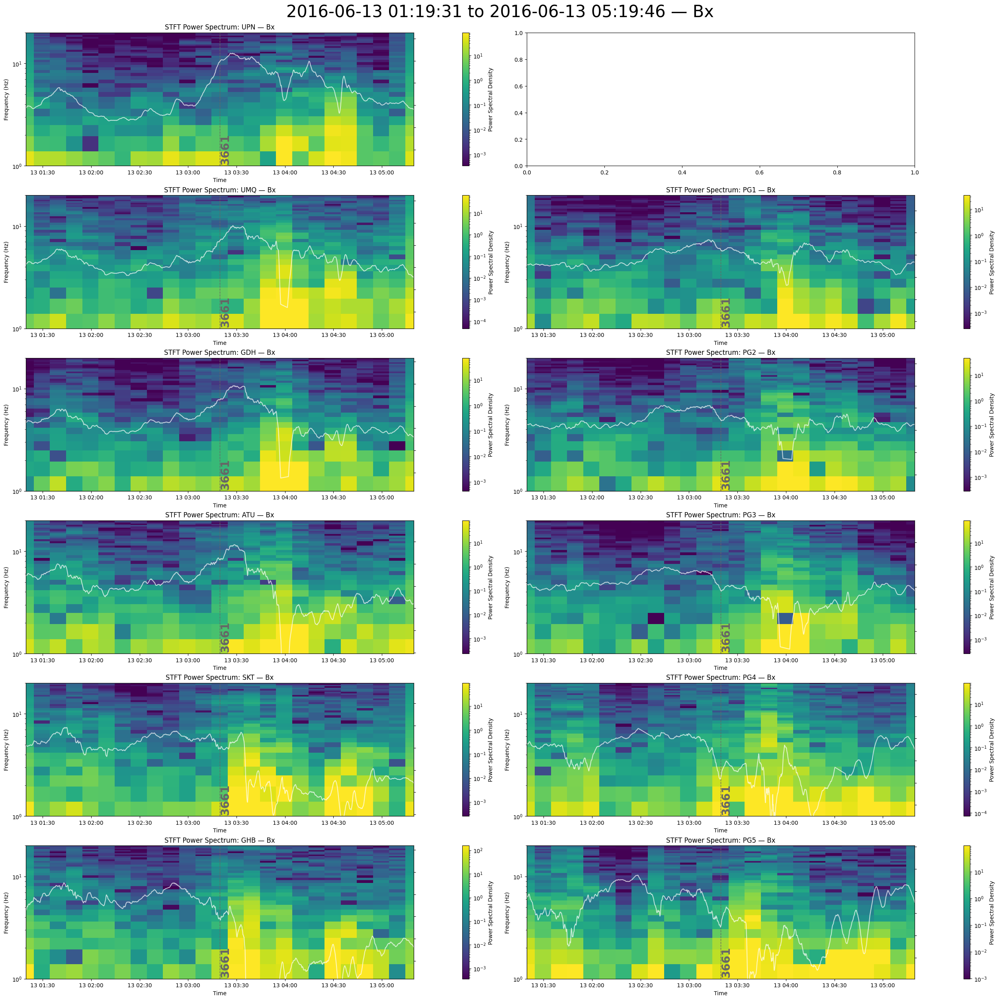

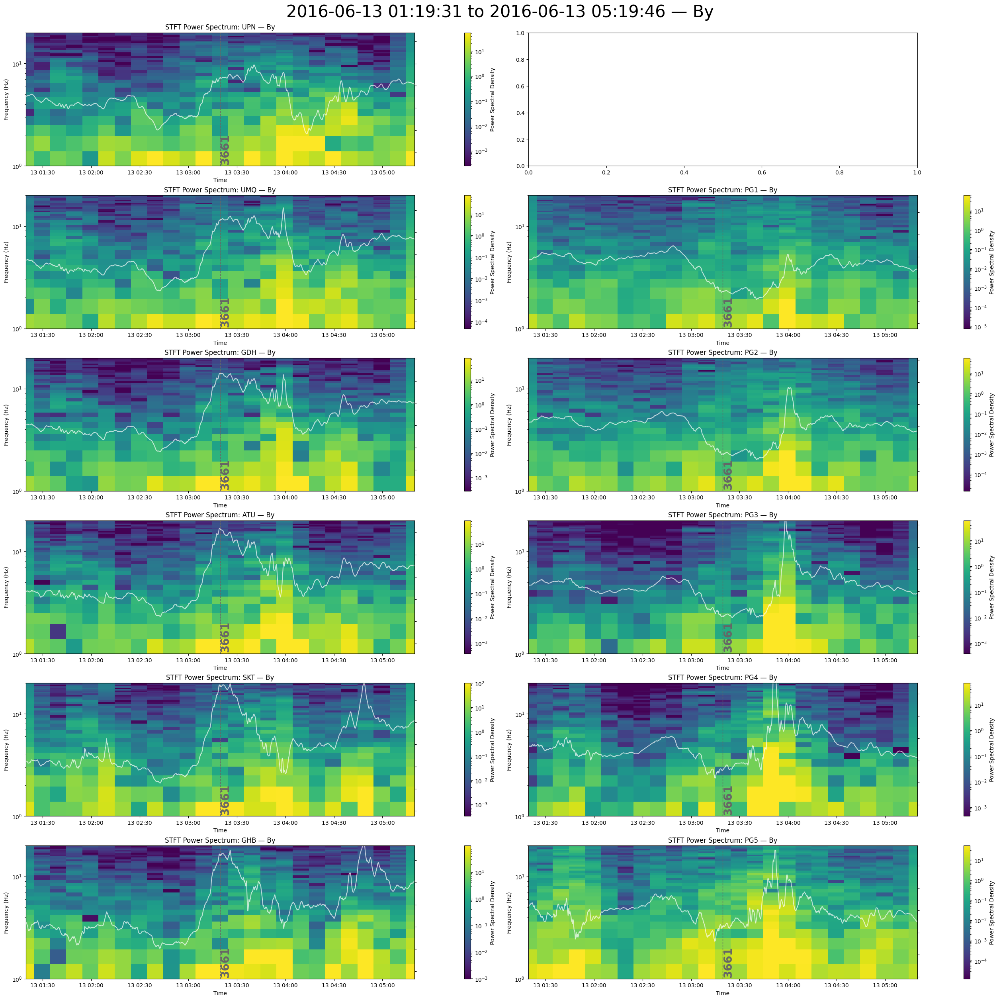

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 33 Axes>

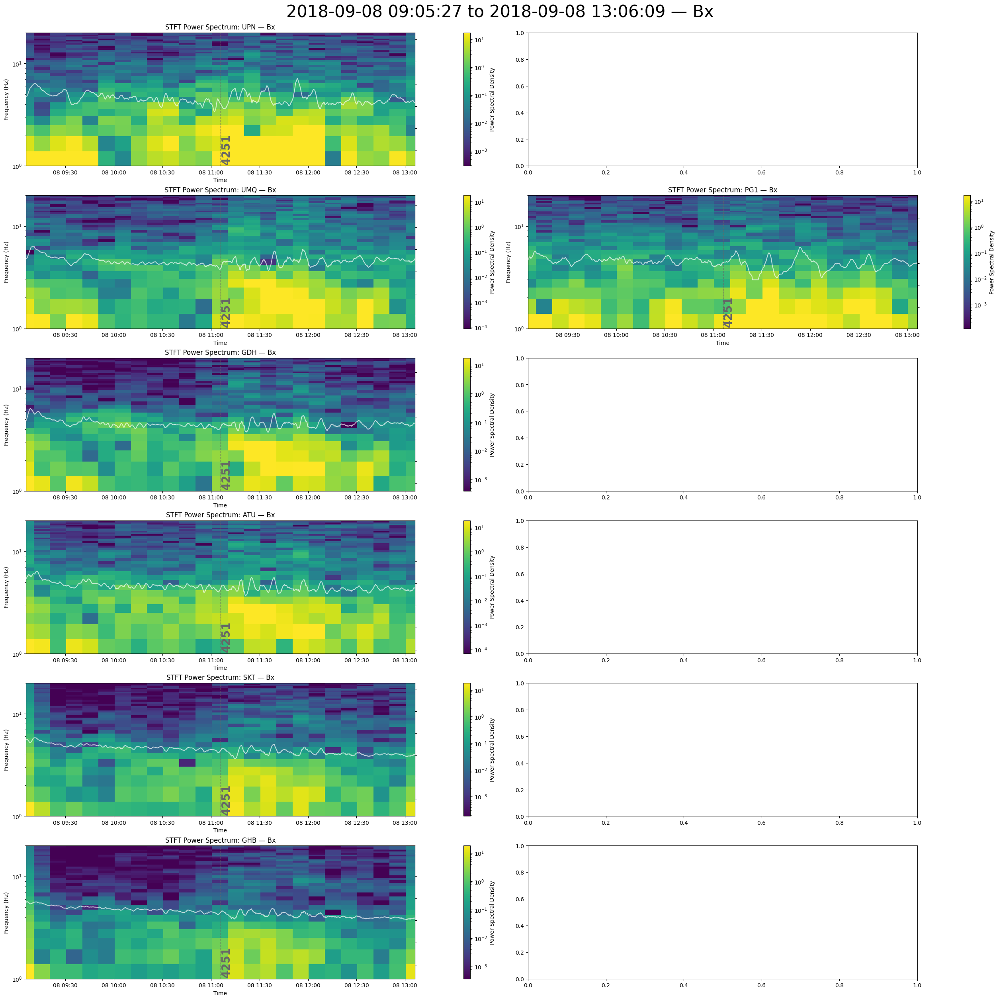

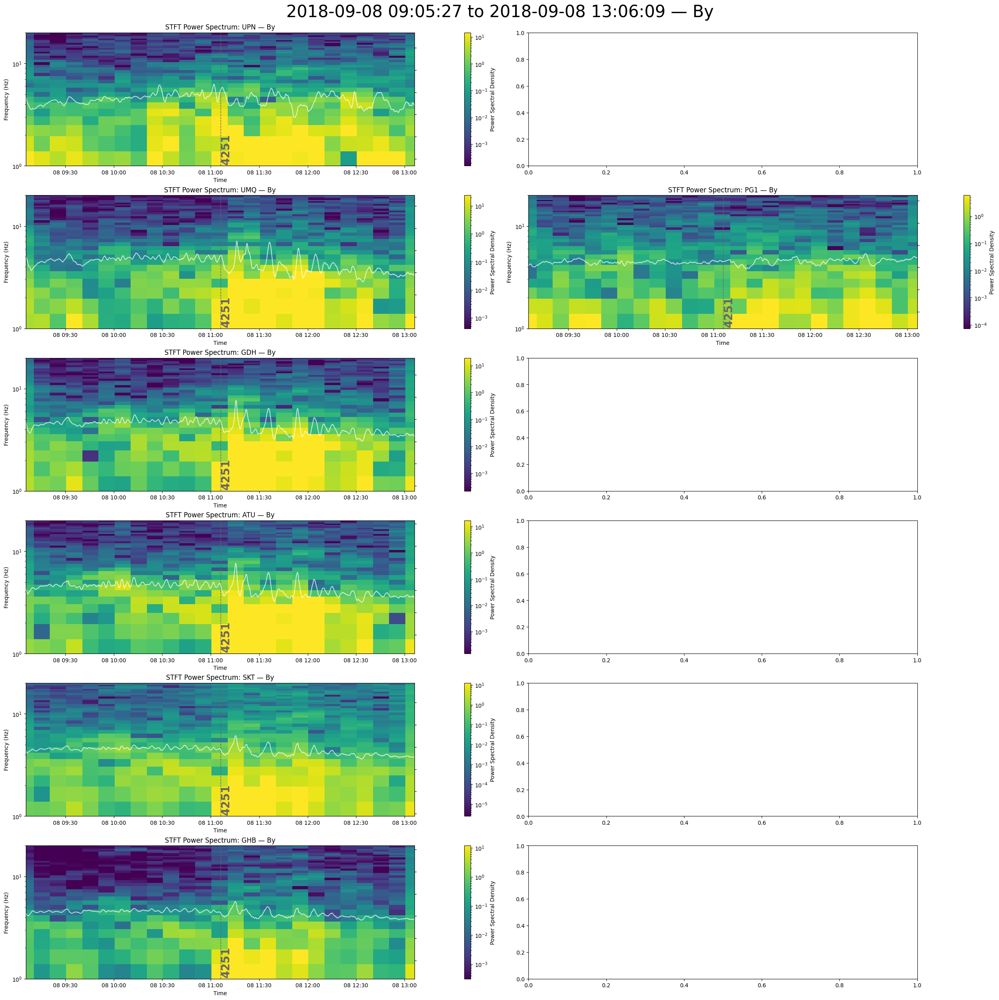

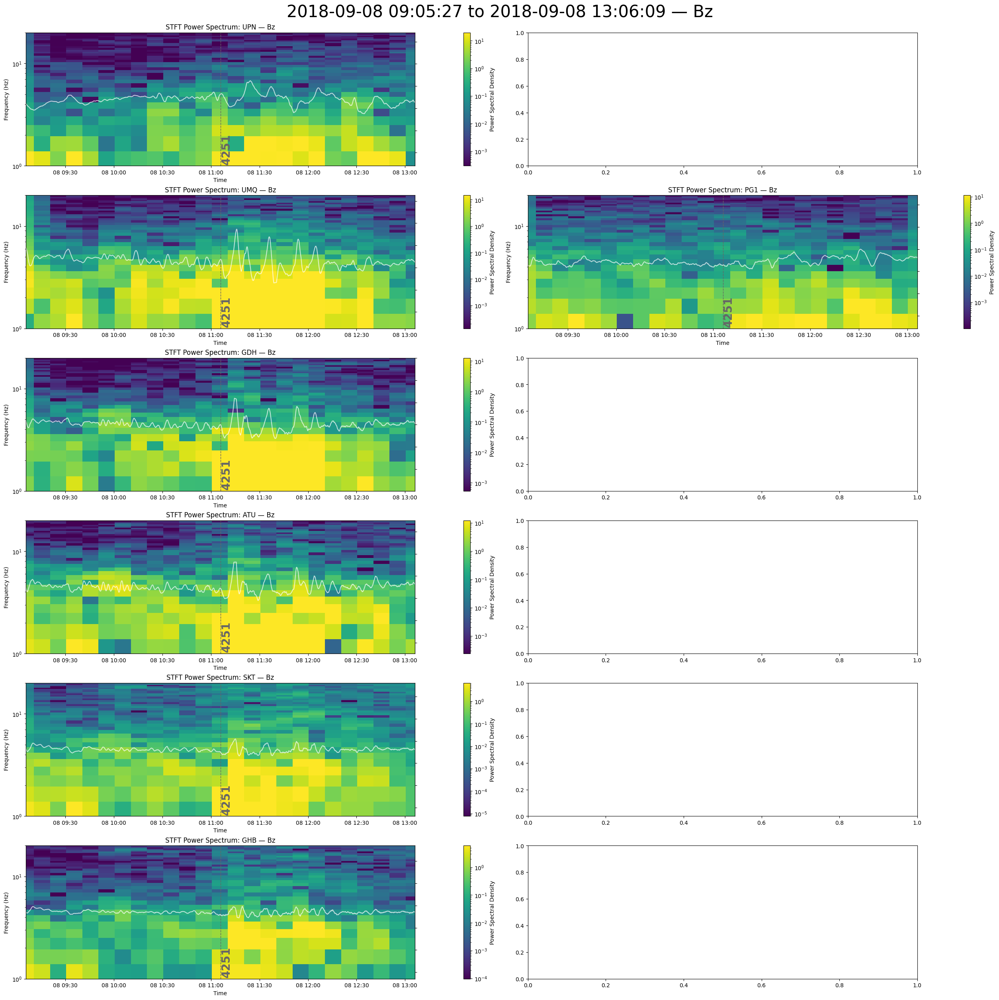

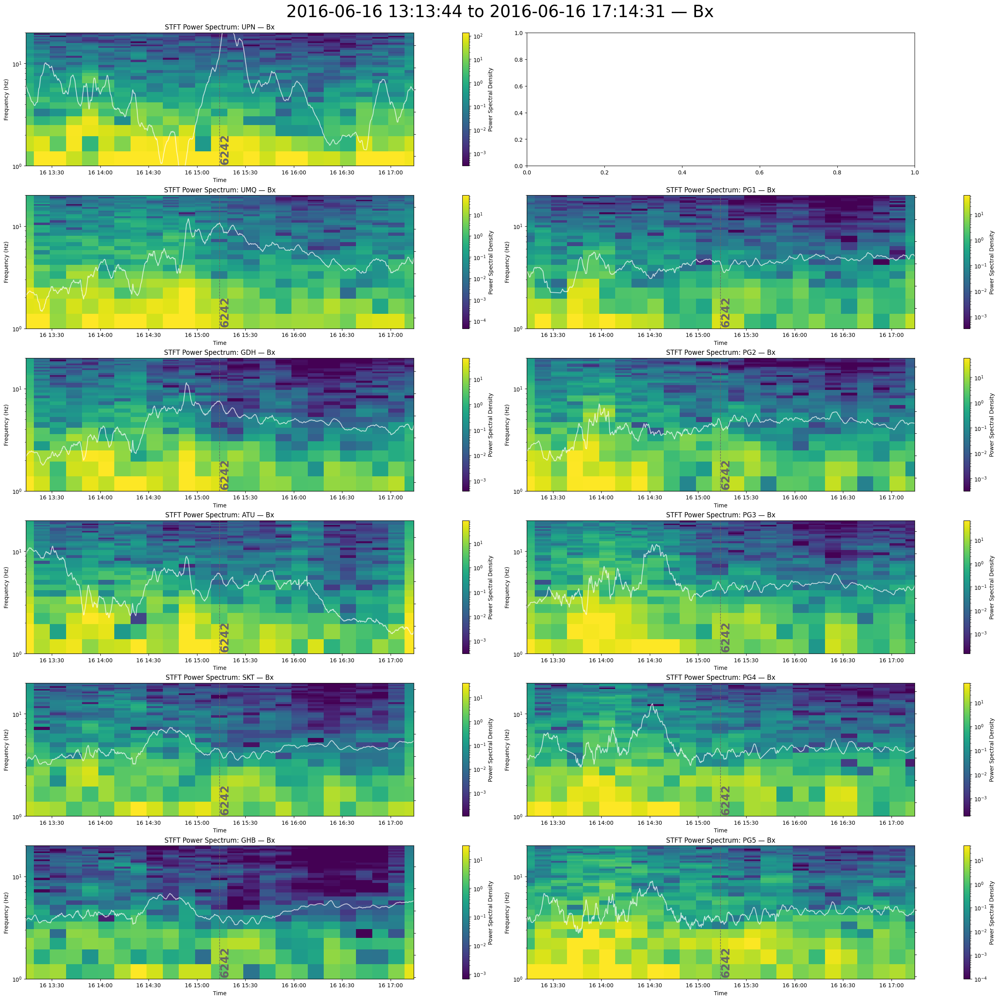

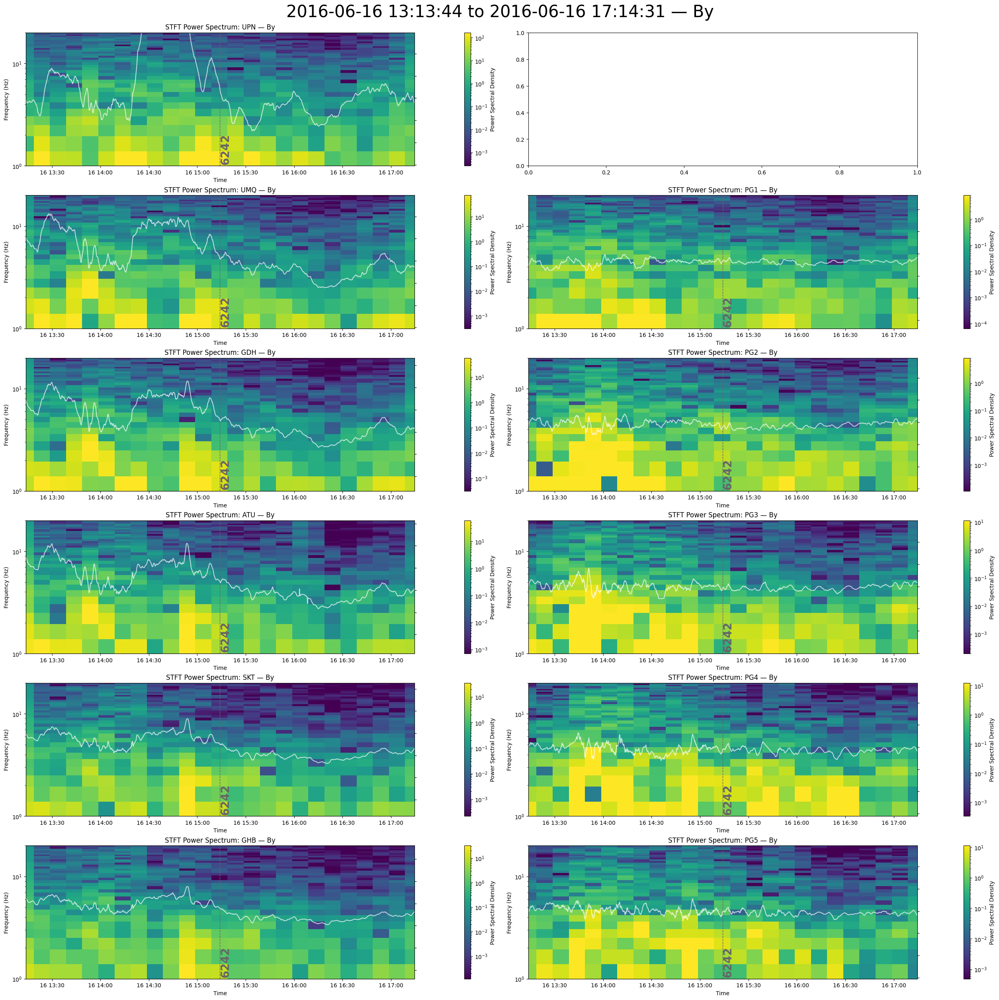

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 33 Axes>

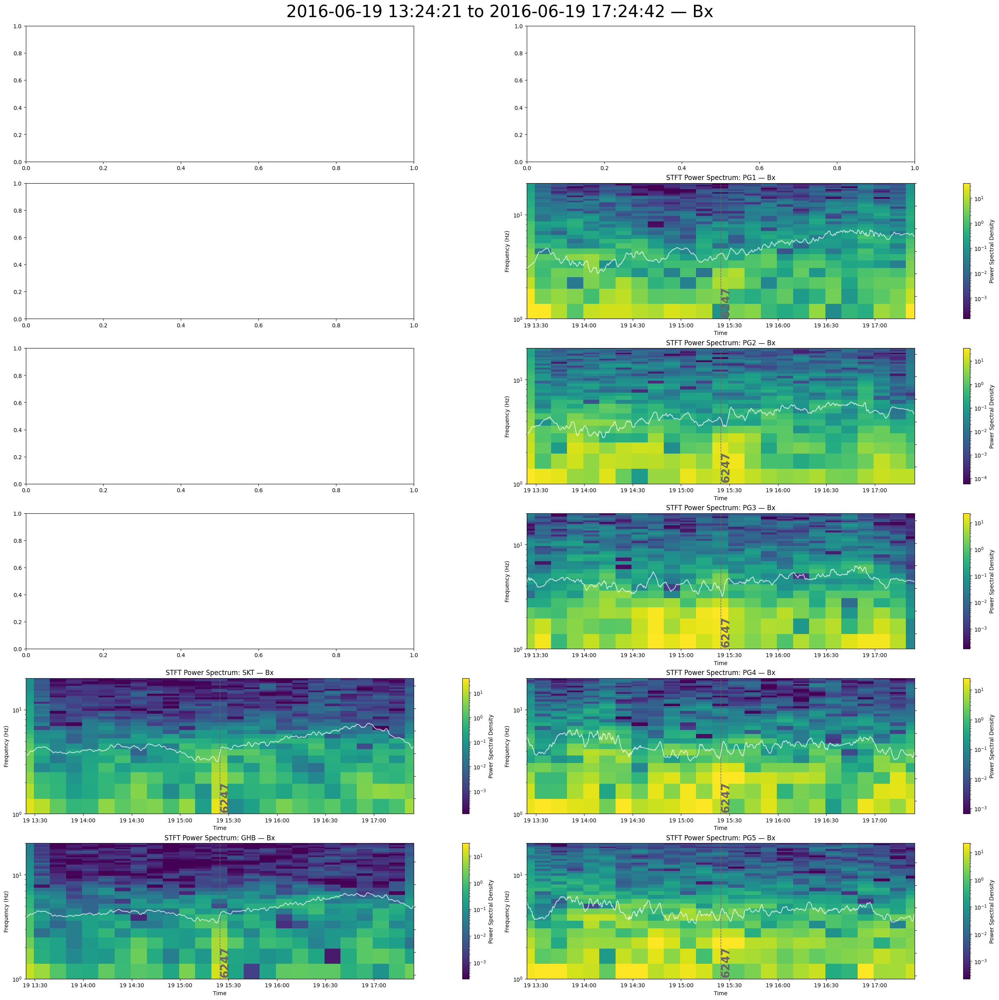

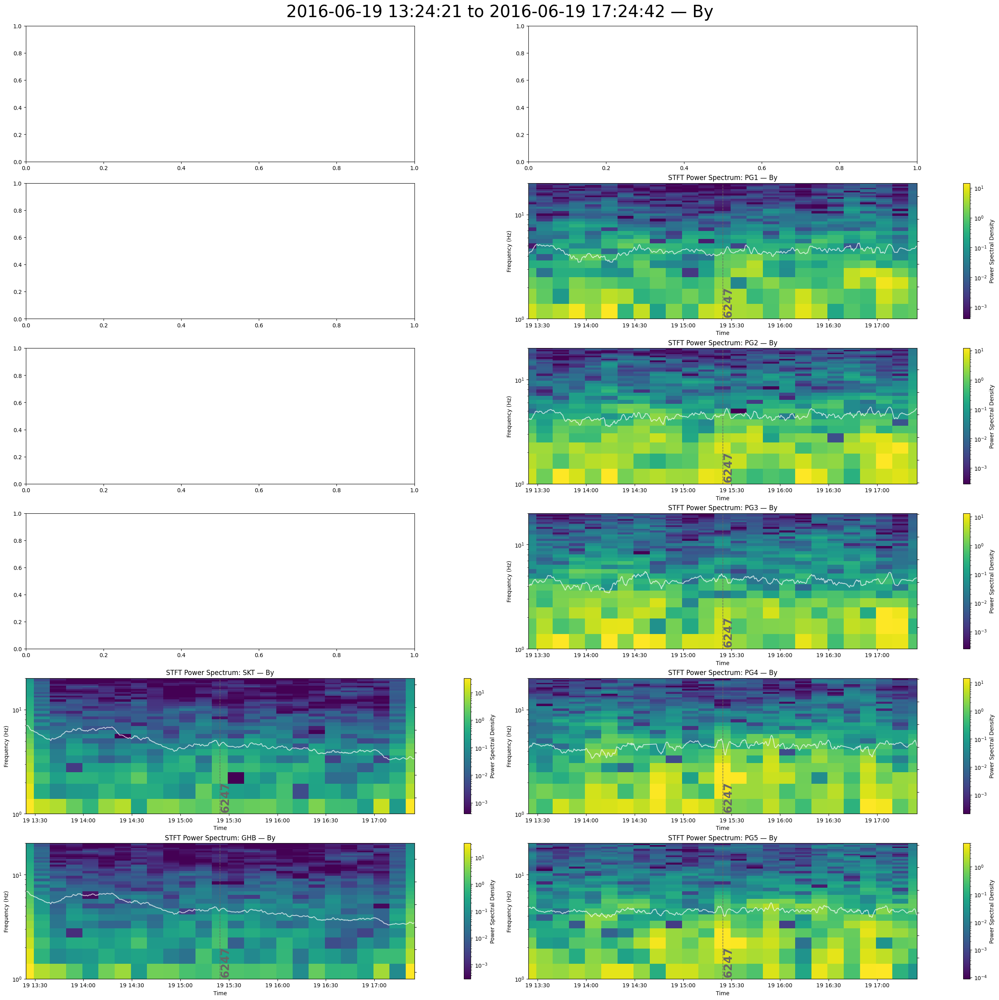

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 25 Axes>

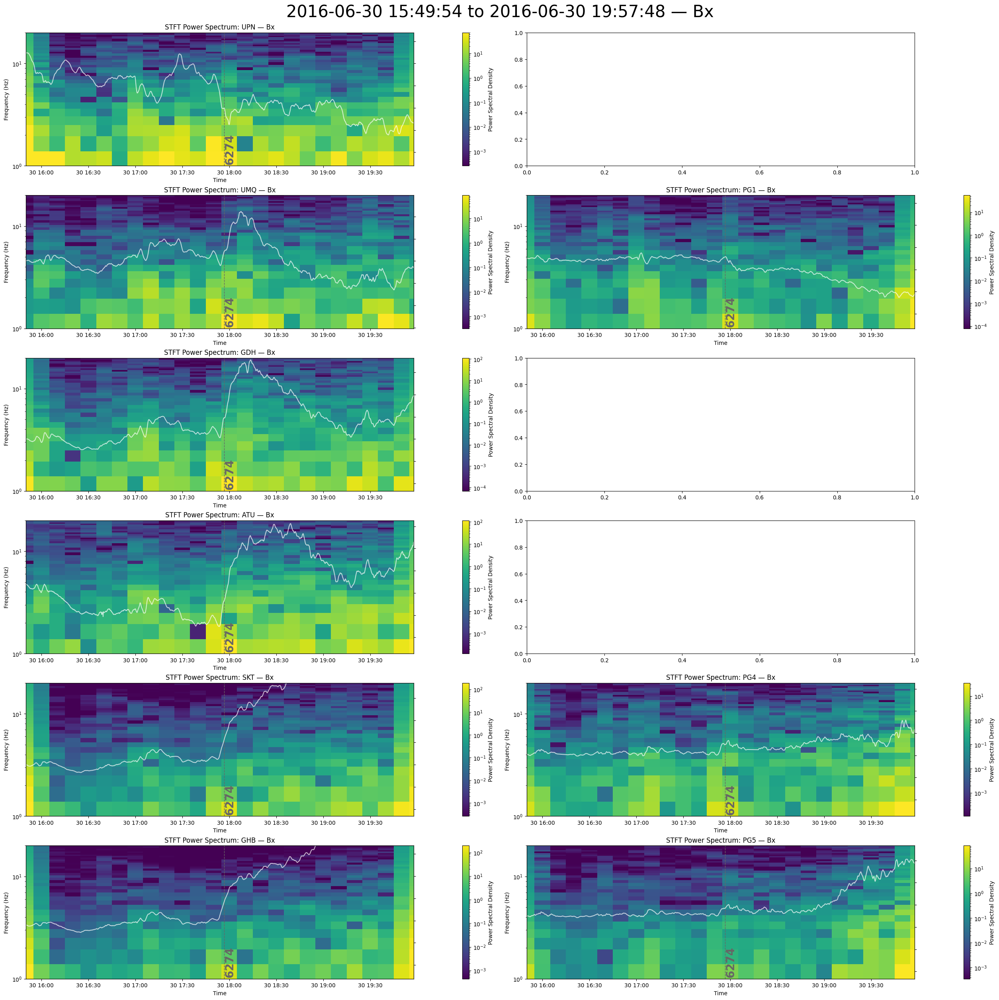

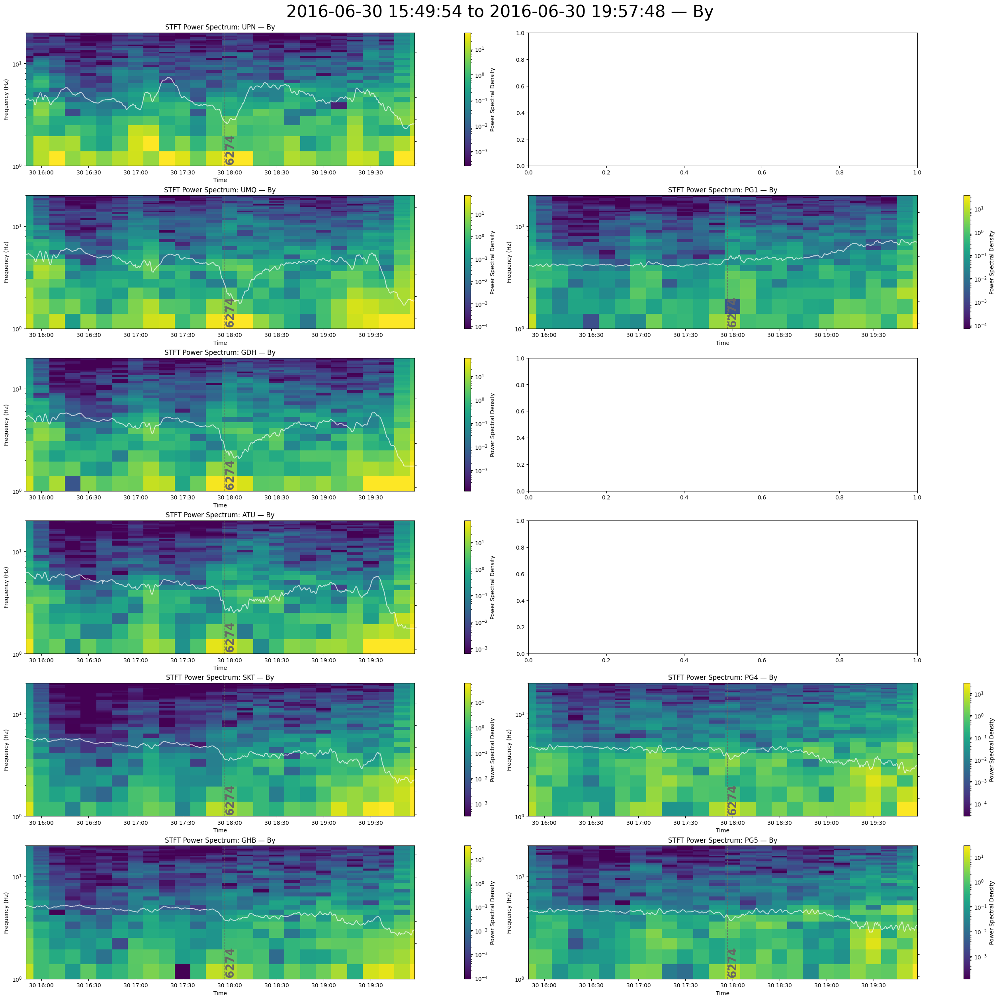

ValueError: Invalid vmin or vmax

<Figure size 2500x2500 with 29 Axes>

In [19]:
# themis_events = themis_events.reset_index()
themis_events = selected_events.copy() # comment out to generate ALL THE PLOTS. Comment in if you don't have a day and a half to run this notebook right now.

for i in themis_events.index:
    print('Computing plots for jet #' + str(themis_events['Jet Number'][i]) + ': ')
    events = themis_events[themis_events.index == i].reset_index()[['Max', 'Jet Number']].rename(columns={"Max": "datetime", "Jet Number": "label"}).to_dict('records')
    print(events)
    # start = themis_events['Start'][i].floor('1d')
    # end = start + pd.Timedelta(hours = 24)
    # print(start)
    # print(end)
    for parameter in ['Bx', 'By', 'Bz']:
        try:
            print('Plotting ' + parameter + ' for jet #' + str(themis_events['Jet Number'][i]) + ': ')
            magspect(parameter = parameter, #start = start, end = end,
            start = (themis_events['Start'][i] - pd.Timedelta(hours=2)).to_pydatetime(),
            end = (themis_events['End'][i]+ pd.Timedelta(hours=2)).to_pydatetime(),
            is_logaxis = True,
            # is_logcolor = False,
            is_verbose = True,
            is_saved = True, 
            fstem = "selected/Jet " + str(themis_events['Jet Number'][i]) + "_",
            # is_overplotted = False,
            # color = 'red', 
            events = events)
            magfig(parameter = parameter, #start = start, end = end,
                # start = themis_events['Start'][1] - pd.Timedelta(hours=2)).to_pydatetime()
                # end = (themis_events['End'][i]+ pd.Timedelta(hours=2)).to_pydatetime(),
                start = (themis_events['Start'][i] - pd.Timedelta(hours=2)).to_pydatetime(),
                end = (themis_events['End'][i]+ pd.Timedelta(hours=2)).to_pydatetime(),
                is_verbose = True,
                is_saved = True, 
                fstem = "selected/Jet " + str(themis_events['Jet Number'][i]) + "_",
                events = events
            )
        except Exception as e:
            print('Error on the plots for jet #' + str(themis_events['Jet Number'][i]) + ': ')
            print(e)
            print('Continuing to next plot...')
            continue


## Generate EIC Quicklook Plots:

In [20]:
from datetime import datetime

def generate_quicklook_url(date_time):
  """Generates a URL for a quicklook plot based on a datetime object.

  Args:
      date_time: A datetime object representing the desired time.

  Returns:
      A string containing the URL for the quicklook plot.

  Example usage:
        datetime_obj = datetime(year=2016, month=6, day=13, hour=3, minute=33)
        quicklook_url = generate_quicklook_url(datetime_obj)
        print(quicklook_url)
  """
  base_url = "https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/"
  year = date_time.year
  month = date_time.month
  day = date_time.day
  hour = str(date_time.hour).zfill(2)  # Convert hour to string before using zfill()
  minute = str(date_time.minute).zfill(2)  # Convert minute to string before using zfill()
  second = str(date_time.second).zfill(2)  # Convert second to string before using zfill()

  # filename = f"SouthEIC{year}{month:02d}{day:02d}_{hour}{minute}{second}.jpg"
  filename = f"SouthEIC{year}{month:02d}{day:02d}_{hour}{minute}00.jpg"
  url = f"{base_url}{year}/{month:02d}/{day:02d}/{filename}"

  return url


for i in selected_events.index:
    datetime_obj = i
    quicklook_url = generate_quicklook_url(datetime_obj)
    print(str(selected_events['Jet Number'][i]) + ": " + quicklook_url)
    # print(quicklook_url)


11: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2013/01/03/SouthEIC20130103_123900.jpg
200: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2014/02/19/SouthEIC20140219_034700.jpg
261: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2015/04/05/SouthEIC20150405_191400.jpg
267: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2015/04/11/SouthEIC20150411_232500.jpg
799: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2016/05/20/SouthEIC20160520_083400.jpg
1031: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2016/06/23/SouthEIC20160623_232100.jpg
1211: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2016/07/08/SouthEIC20160708_212900.jpg
3270: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2015/04/18/SouthEIC20150418_031000.jpg
3461: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2015/05/15/SouthEIC20150515_052500.jpg
3661: https://vmo.igpp.ucla.edu/data1/SECS/Southernquicklook/2016/06/13/SouthEIC20160613_031900.jpg
4251: 